# ESPosition Evaluation

In [2]:
target_macs = [ 
    "20f094118214", # Pixel
    "342eb61ec446", # P20
    "d81c79de34e1" # iPhone
]

device_names = {
    "20f094118214": "Google Pixel 9 Pro XL",
    "342eb61ec446": "Huawei P20 Pro",
    "d81c79de34e1": "Apple iPhone XR"
}

monitor_macs_esp8266 = [
    "483fda467e7a",
    "d8bfc0117c7d",
    "24a1602ccfab",
    "a4cf12fdaea9",
]

monitor_macs_esp32 = [
    "a0a3b3ff35c0",
    "f8b3b734347c",
    "a0a3b3ff66b4",
    "08a6f7a1e5c8",
    "f8b3b732fb6c",
    "f8b3b73303e8",
]

monitor_macs_all = monitor_macs_esp8266 + monitor_macs_esp32

def filter_esp8266(df):
    return df[df["monitor_mac"].isin(monitor_macs_esp8266)]

def filter_esp32(df):
    return df[df["monitor_mac"].isin(monitor_macs_esp32)]

In [5]:
import os
import pandas as pd
import re

## Prepare the data

In [3]:
import os
import pandas as pd
import re

# Define input and output base directories
input_base = "./data/original"
output_base = "./data/filtered"

# Regular expression to match and strip date prefixes
date_pattern = r"^\d{4}_\d{2}_\d{2}_\d{2}_\d{2}_\d{2}_"

def replace_macs(df):
    mac_replacements = {
        "f6049f6df5e6": "20f094118214"
    }
    columns = ["monitor_mac", "target_mac"]
    for col in columns:
        df[col] = df[col].replace(mac_replacements)

    return df

def filter_target_macs(df):
    return df[df["target_mac"].isin(target_macs)]

# Walk through each subfolder in the input directory
for subfolder in os.listdir(input_base):
    input_folder = os.path.join(input_base, subfolder)
    
    # Ensure it's a directory
    if os.path.isdir(input_folder):
        output_folder = os.path.join(output_base, subfolder)
        
        # Create the output subfolder if it doesn't exist
        os.makedirs(output_folder, exist_ok=True)
        
        # Process all CSV files in the current subfolder
        for filename in os.listdir(input_folder):
            if filename.endswith(".csv"):
                input_file_path = os.path.join(input_folder, filename)
                print(f"Processing: {input_file_path}")
                
                # Read the CSV file
                df = pd.read_csv(input_file_path)

                df = replace_macs(df)
                df = filter_target_macs(df)
                
                # Remove the date prefix from the filename
                cleaned_filename = re.sub(date_pattern, "", filename)
                
                # Define the output file path
                output_file_path = os.path.join(output_folder, cleaned_filename)
                
                # Save the processed file
                df.to_csv(output_file_path, index=False)
                print(f"Saved: {output_file_path}")

print("Processing complete.")

Processing: ./data/original\apb\2024_12_11_12_48_56_Pixel9.csv
Saved: ./data/filtered\apb\Pixel9.csv
Processing: ./data/original\apb\2024_12_12_10_17_51_iPhone.csv
Saved: ./data/filtered\apb\iPhone.csv
Processing: ./data/original\apb\2024_12_12_10_43_30_P20_Pro.csv
Saved: ./data/filtered\apb\P20_Pro.csv
Processing: ./data/original\apb\2024_12_12_11_31_48_Pixel9_eval.csv
Saved: ./data/filtered\apb\Pixel9_eval.csv
Processing: ./data/original\apb\2024_12_12_11_54_13_iPhone_eval.csv
Saved: ./data/filtered\apb\iPhone_eval.csv
Processing: ./data/original\apb\2024_12_12_12_20_42_P20_Pro_eval.csv
Saved: ./data/filtered\apb\P20_Pro_eval.csv
Processing: ./data/original\apb\2024_12_12_13_04_53_Pixel9_path_youtube.csv
Saved: ./data/filtered\apb\Pixel9_path_youtube.csv
Processing: ./data/original\apb\2024_12_12_13_08_00_Pixel9_path_spotify.csv
Saved: ./data/filtered\apb\Pixel9_path_spotify.csv
Processing: ./data/original\apb\2024_12_12_13_12_20_Pixel9_path_standby.csv
Saved: ./data/filtered\apb\Pix

## General Information

In [3]:
def get_unique_points_(file_path, x_col, y_col, filter_col=None):
    # Load the CSV file
    df = pd.read_csv(file_path)

    # Extract the distinct points as a set of tuples
    if filter_col is not None:
        distinct_df = df[[filter_col, x_col, y_col]]
    else:
        distinct_df = df[[x_col, y_col]]

    distinct_df = distinct_df.drop_duplicates()
    
    # Sort by y coordinate, then by x coordinate
    sorted_df = distinct_df.sort_values(by=[y_col, x_col]).reset_index(drop=True)
    
    # Print all distinct points
    return sorted_df

### APB

In [8]:
print("All Anchor Positions:\n")
get_unique_points_("./data/filtered/apb/Pixel9.csv", "anchor_position_x", "anchor_position_y", "monitor_mac")

All Anchor Positions:



,monitor_mac,anchor_position_x,anchor_position_y
0,08a6f7a1e5c8,884,45
1,483fda467e7a,1461,241
2,f8b3b732fb6c,1461,241
3,a4cf12fdaea9,861,580
4,f8b3b73303e8,861,580
5,d8bfc0117c7d,107,884
6,a0a3b3ff66b4,107,884
7,f8b3b734347c,1047,884
8,24a1602ccfab,2048,884
9,a0a3b3ff35c0,2048,884


In [9]:
print("All Fingerprint Positions:\n")
get_unique_points_("./data/filtered/apb/Pixel9.csv", "target_position_x", "target_position_y")

All Fingerprint Positions:



,target_position_x,target_position_y
0,937.642325,94.047389
1,1338.291192,94.047389
2,1148.736890,161.540208
3,1338.291192,290.781779
4,939.078343,292.217796
5,1336.855175,490.388203
6,939.078343,491.824221
7,1138.684768,493.260238
8,1062.575843,652.658175
9,881.637645,781.899745


### Flat

In [7]:
print("All Anchor Positions:\n")
get_unique_points_("./data/filtered/flat/Pixel9.csv", "anchor_position_x", "anchor_position_y", "monitor_mac")

All Anchor Positions:



,monitor_mac,anchor_position_x,anchor_position_y
0,f8b3b732fb6c,62,42
1,483fda467e7a,62,42
2,08a6f7a1e5c8,270,387
3,d8bfc0117c7d,556,510
4,a0a3b3ff66b4,556,510
5,a4cf12fdaea9,56,723
6,f8b3b73303e8,56,723
7,24a1602ccfab,744,844
8,a0a3b3ff35c0,744,844
9,f8b3b734347c,441,934


In [8]:
print("All Fingerprint Positions:\n")
get_unique_points_("./data/filtered/flat/Pixel9.csv", "target_position_x", "target_position_y")

All Fingerprint Positions:



,target_position_x,target_position_y
0,134.168052,112.177831
1,282.858345,112.177831
2,428.280719,112.177831
3,282.858345,260.868123
4,431.548638,260.868123
5,134.168052,262.502083
6,132.534093,411.192375
7,282.858345,411.192375
8,433.182597,416.094253
9,505.076805,543.543076


## RSSI over Time

In [10]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Enable inline plotting in Jupyter Lab
%matplotlib inline

def euclidean_distance(x1, y1, x2, y2):
    """Calculate the Euclidean distance between two points (x1, y1) and (x2, y2)."""
    return np.sqrt((x2 - x1)**2 + (y2 - y1)**2) / 100

def plot_rssi_over_time(csv_file, monitor_mac_col="monitor_mac", timestamp_col="timestamp", rssi_col="rssi", target_position_x_col="target_position_x", target_position_y_col="target_position_y", anchor_position_x_col="anchor_position_x", anchor_position_y_col="anchor_position_y"):
    # Load the CSV file
    df = pd.read_csv(csv_file)
    
    # Check if required columns exist
    for col in [monitor_mac_col, timestamp_col, rssi_col]:
        if col not in df.columns:
            raise ValueError(f"Error: Column '{col}' not found in the CSV file.")

    # Get unique target positions (combinations of x and y coordinates)
    target_positions = df[[target_position_x_col, target_position_y_col]].drop_duplicates()

    # Get unique anchor positions (combinations of x and y coordinates)
    anchor_positions = df[[monitor_mac_col, anchor_position_x_col, anchor_position_y_col]].drop_duplicates()

    # Get unique monitor MAC addresses (assumed there are 10 nodes)
    monitor_macs = df[monitor_mac_col].unique()

    # Iterate over each target location and create a separate figure
    for target_index, (x, y) in target_positions.iterrows():
        target_data = df[(df[target_position_x_col] == x) & (df[target_position_y_col] == y)]
        
        # Create a new figure for each target location
        plt.figure(figsize=(15, 10))
        
        # Plot RSSI for each monitor node at the current target location
        for i, monitor_mac in enumerate(monitor_macs[:10]):  # Assuming 10 monitor nodes
            plt.subplot(5, 2, i + 1)  # 2 rows, 5 columns for the subplots
            
            node_data = target_data[target_data[monitor_mac_col] == monitor_mac].copy()

            # Subtract the minimum timestamp to start from 0 for plotting
            node_data[timestamp_col] = node_data[timestamp_col] - node_data[timestamp_col].min()
            
            # Plot the RSSI values over time for the current monitor node at the current target location
            plt.plot(node_data[timestamp_col], node_data[rssi_col], label=f'Monitor {monitor_mac}')

            # Calculate the Euclidean distance between the target and each anchor
            anchor_position = anchor_positions[anchor_positions[monitor_mac_col] == monitor_mac].iloc[0]
            (ax, ay) = (float(anchor_position[anchor_position_x_col]), float(anchor_position[anchor_position_y_col]))
            distance = euclidean_distance(x, y, ax, ay)
            
            # Add the Euclidean distance to the plot label
            plt.title(f'RSSI - {monitor_mac}\nDistance: {distance:.2f} m')
            plt.xlabel('Time (seconds)')
            plt.ylabel('RSSI')
            plt.tight_layout()
        
        # Show the plot for the current target location
        plt.suptitle(f'RSSI over Time for Target Location ({x}, {y})', fontsize=16)
        plt.show()

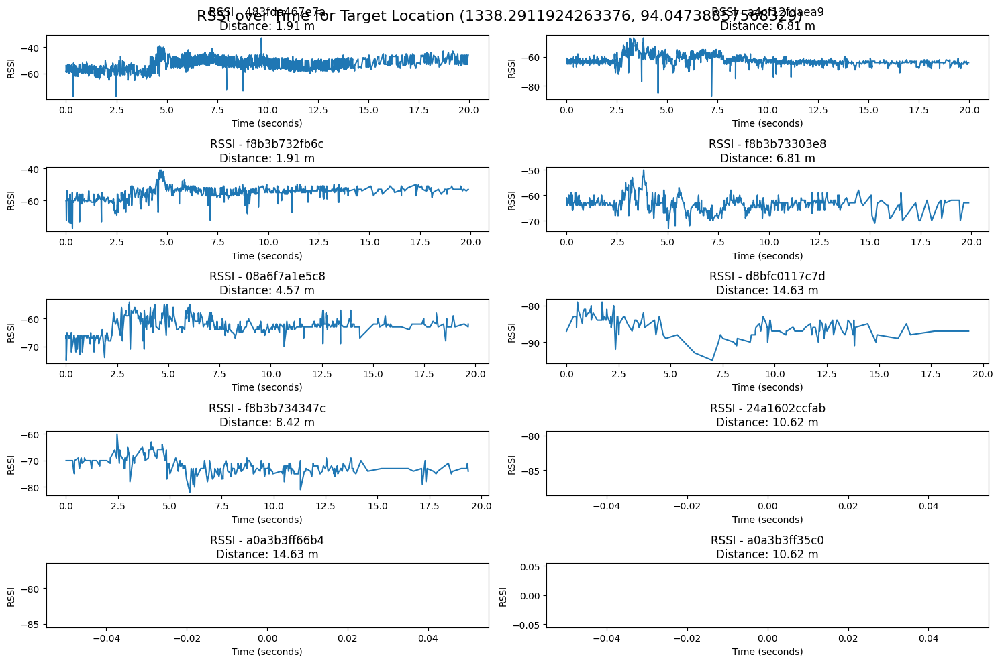

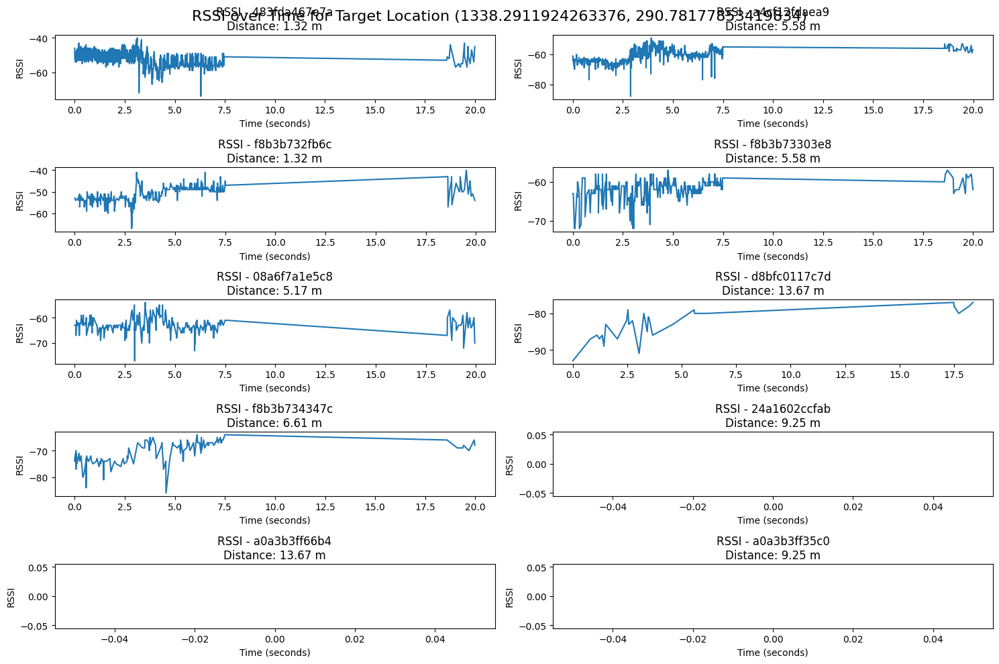

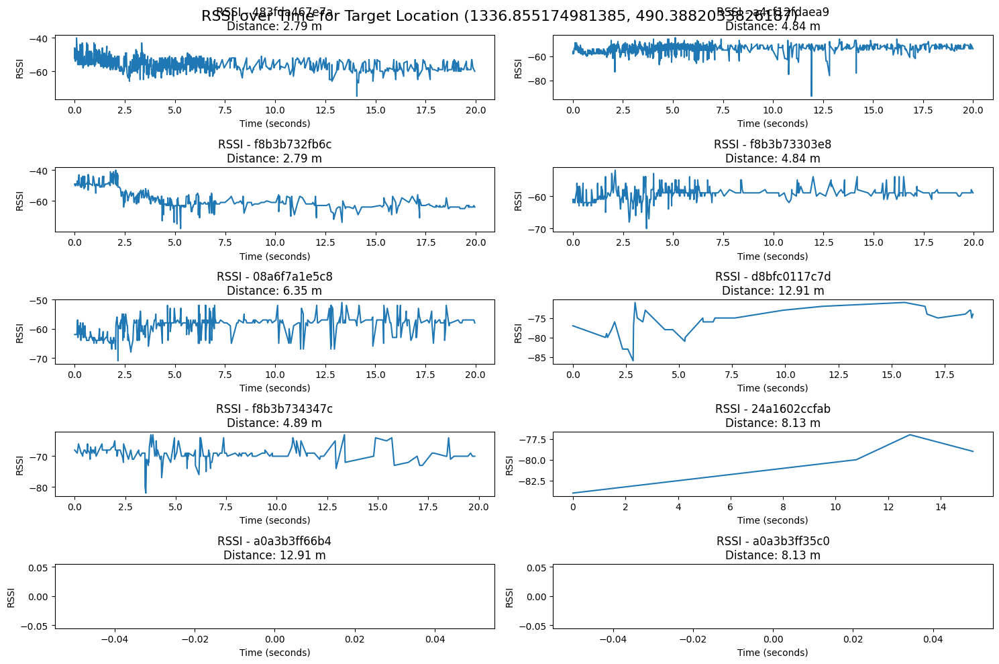

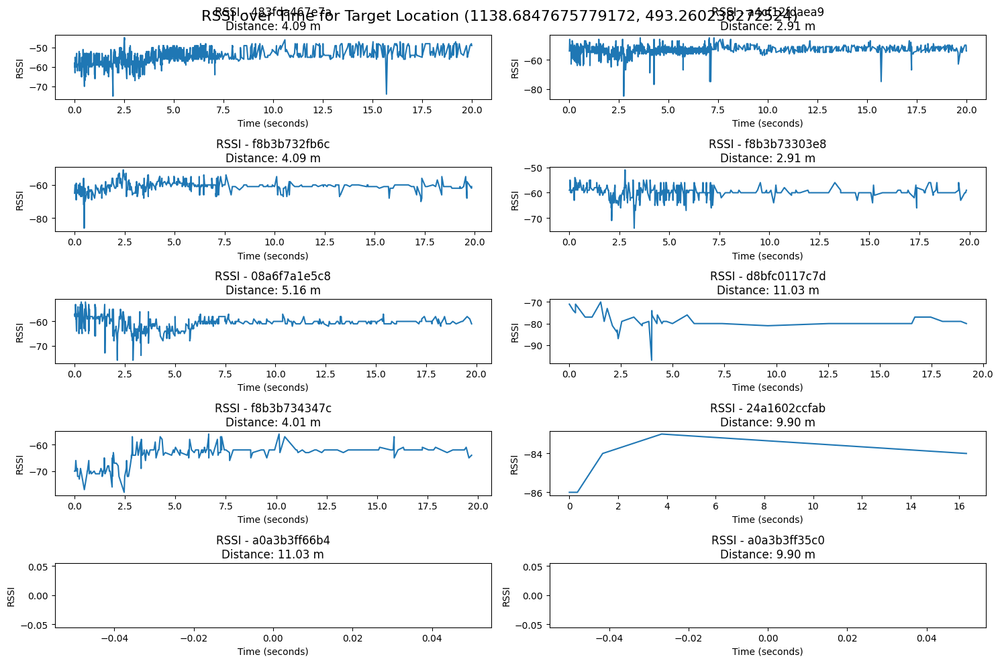

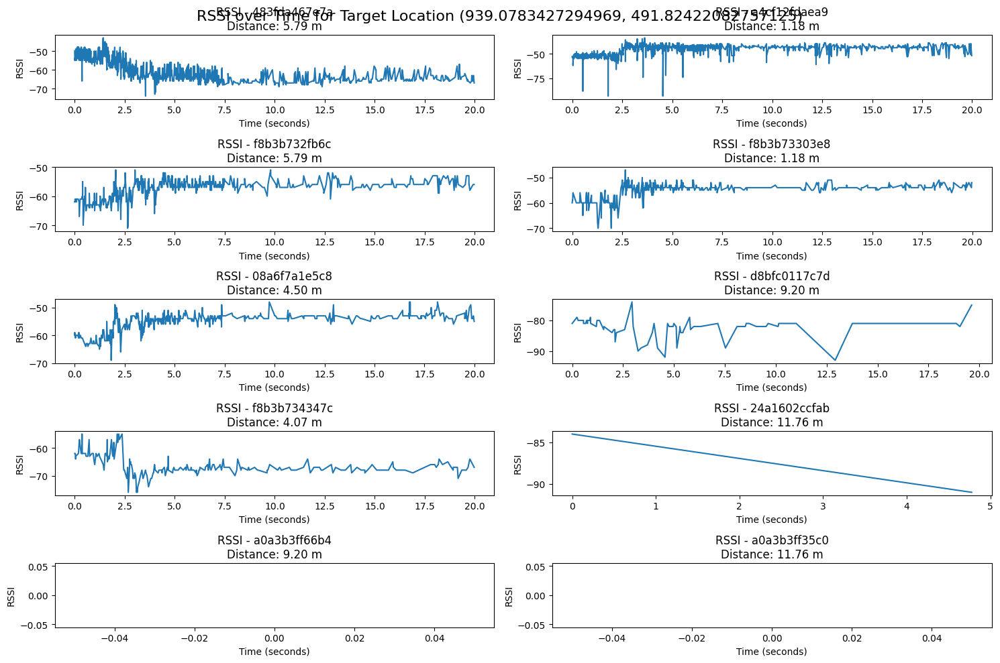

...

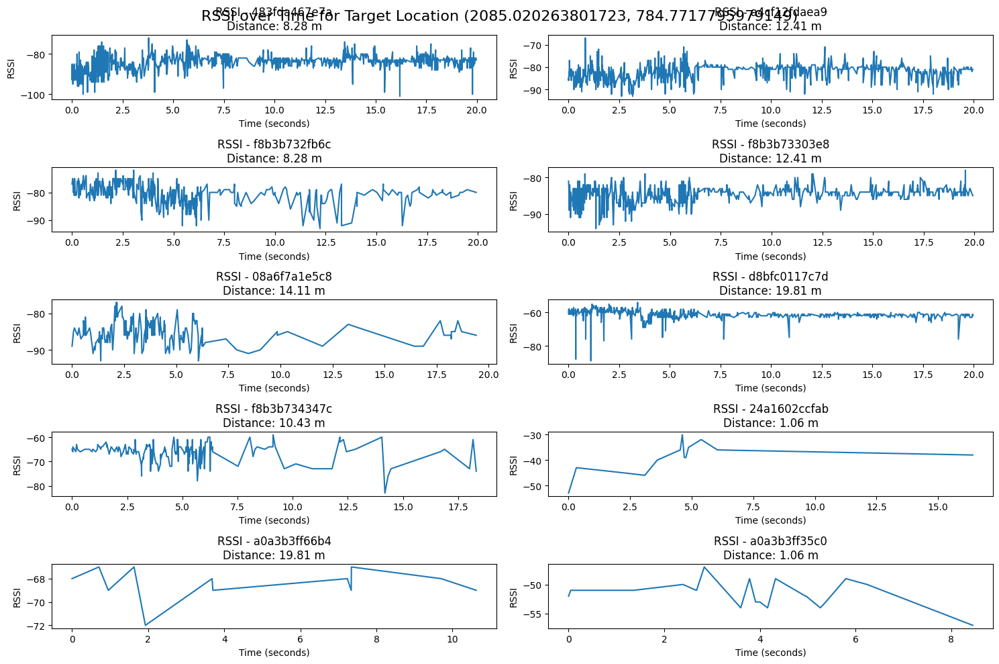

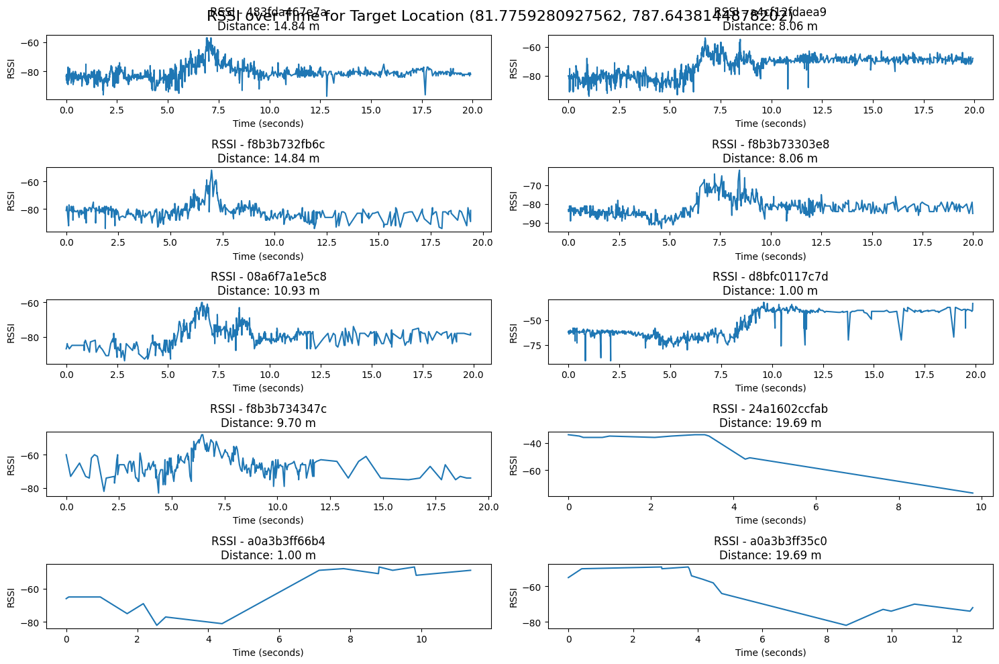

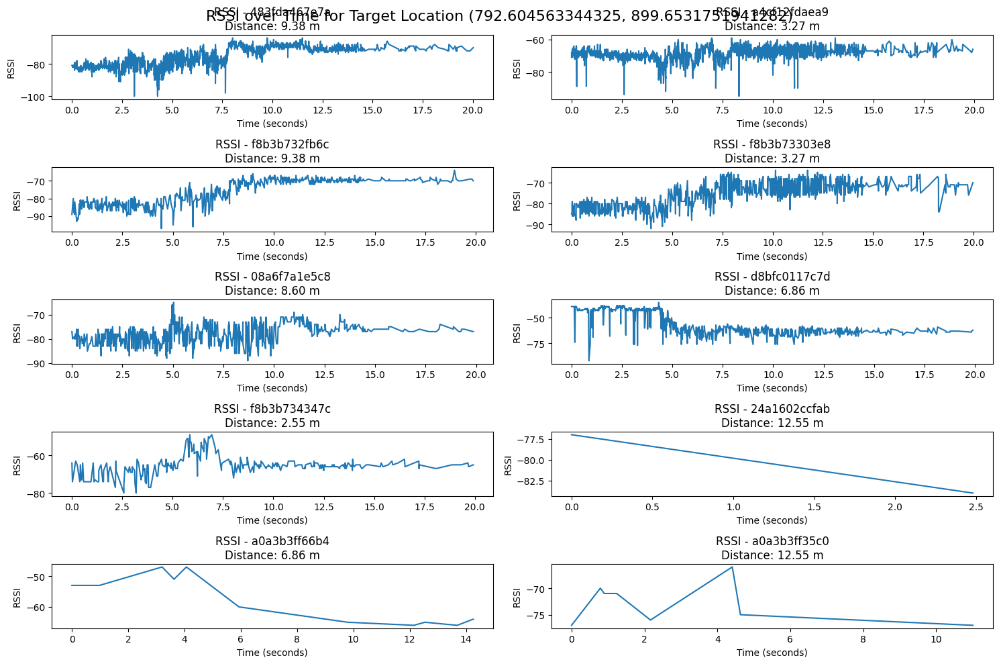

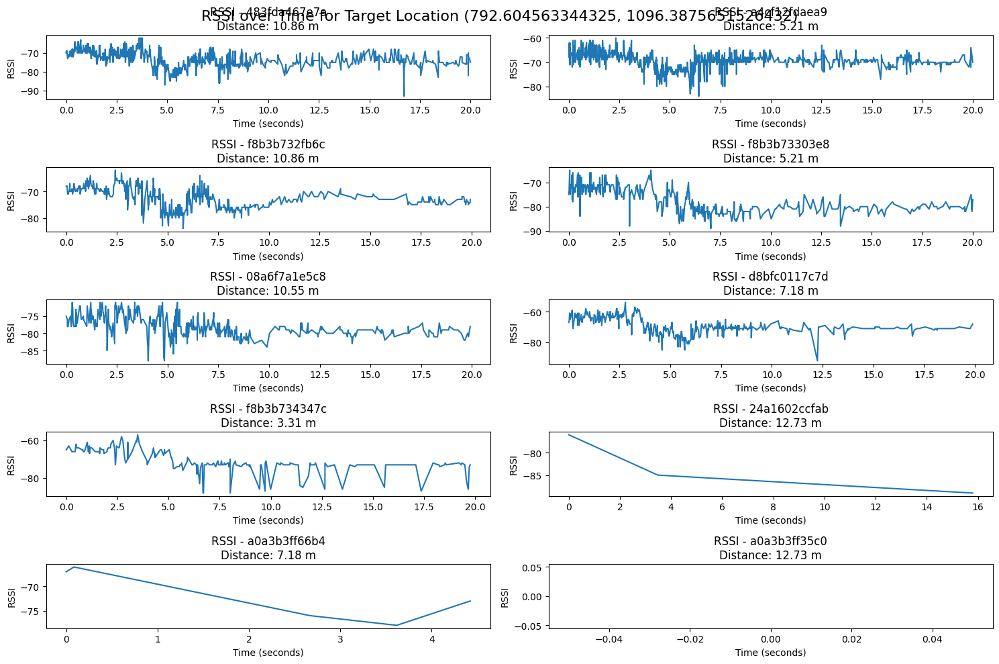

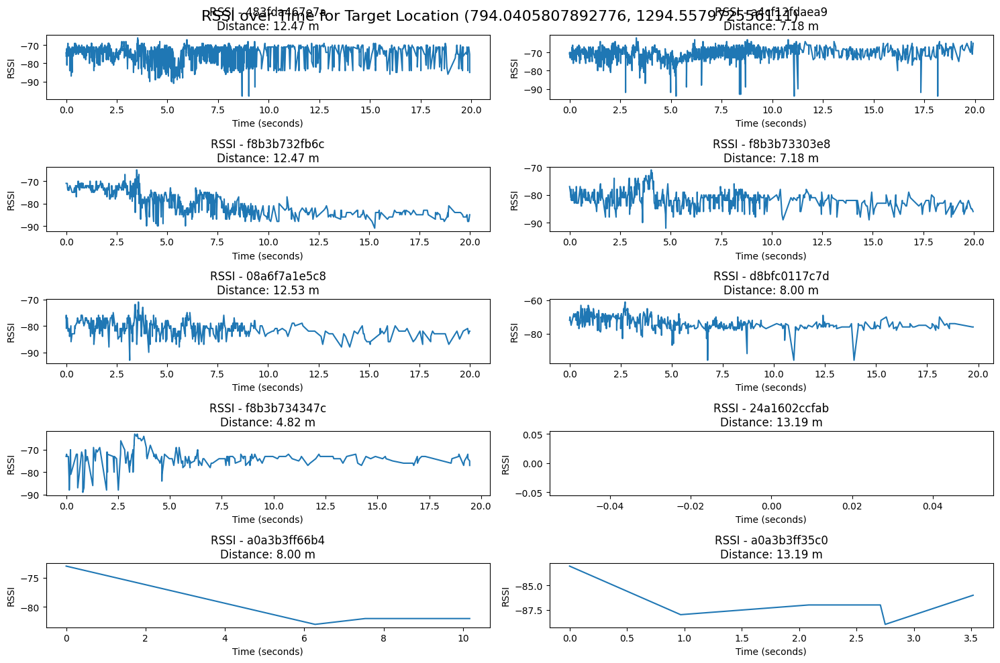

In [12]:
plot_rssi_over_time("./data/filtered/apb/Pixel9.csv")

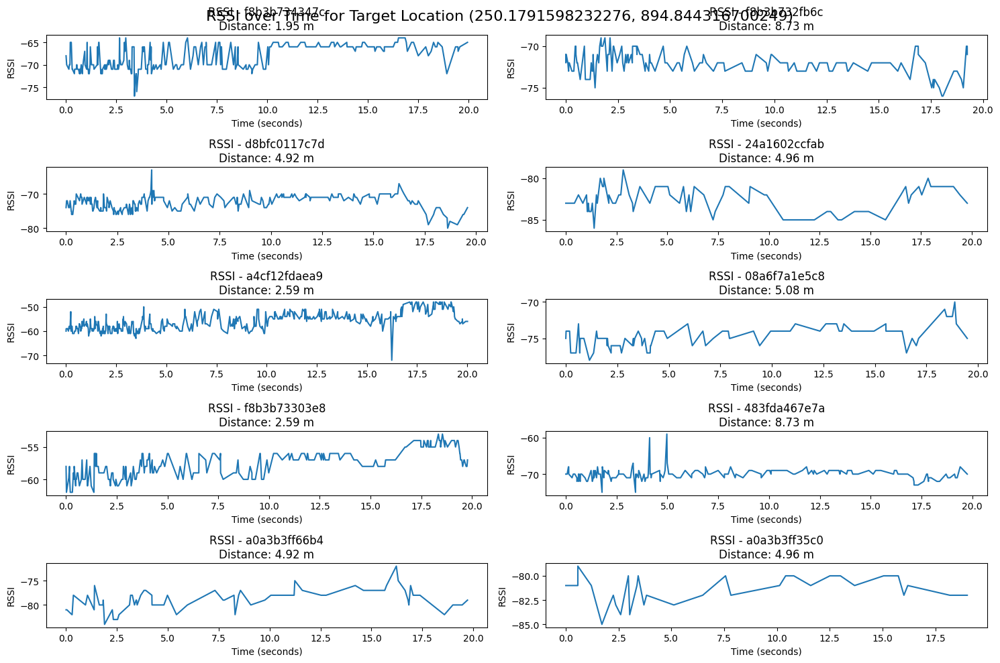

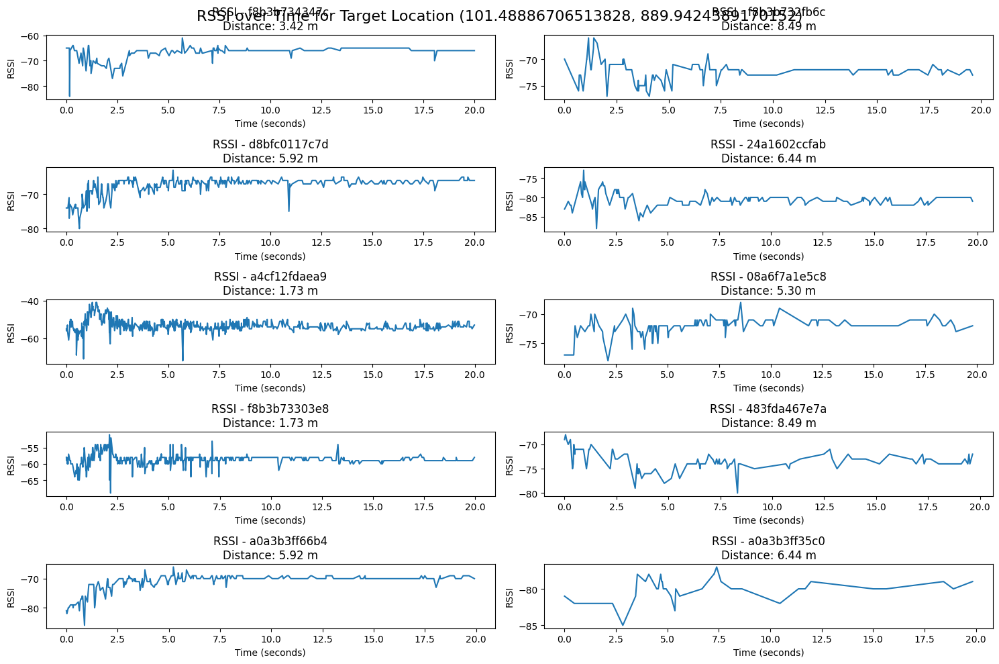

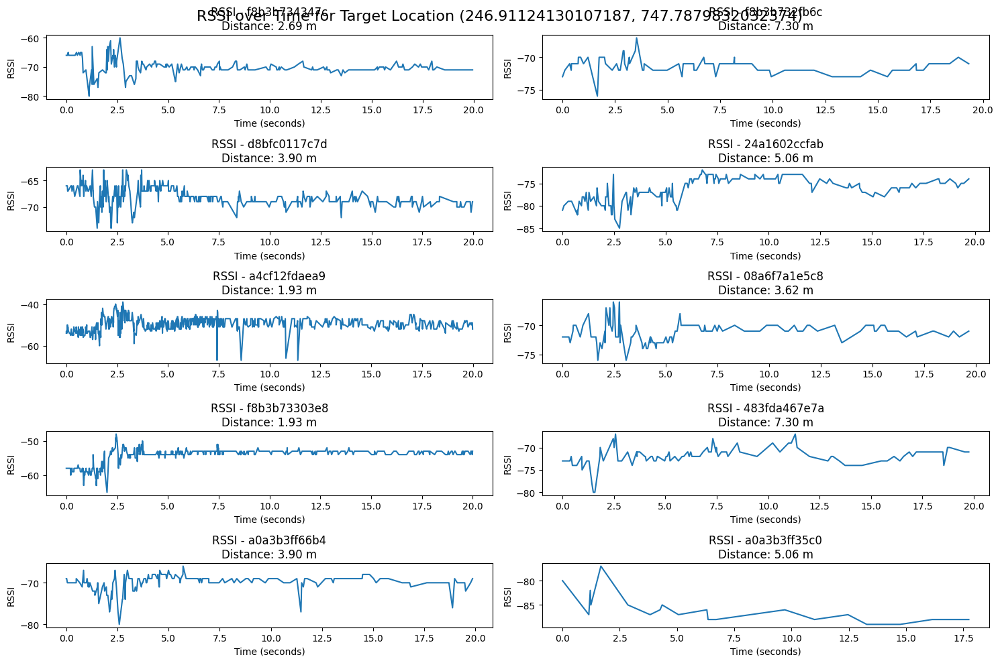

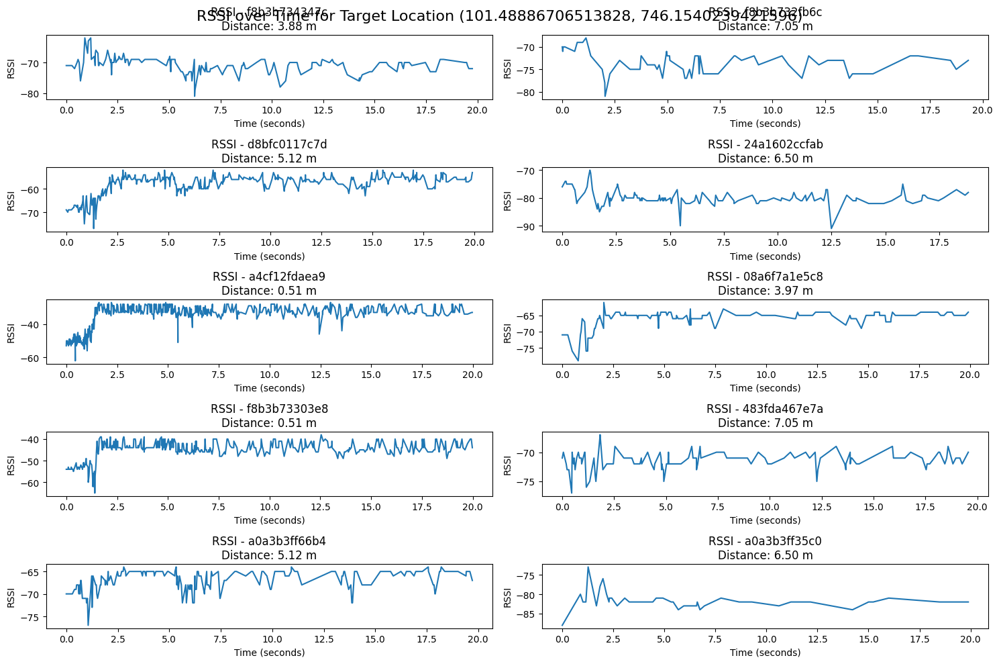

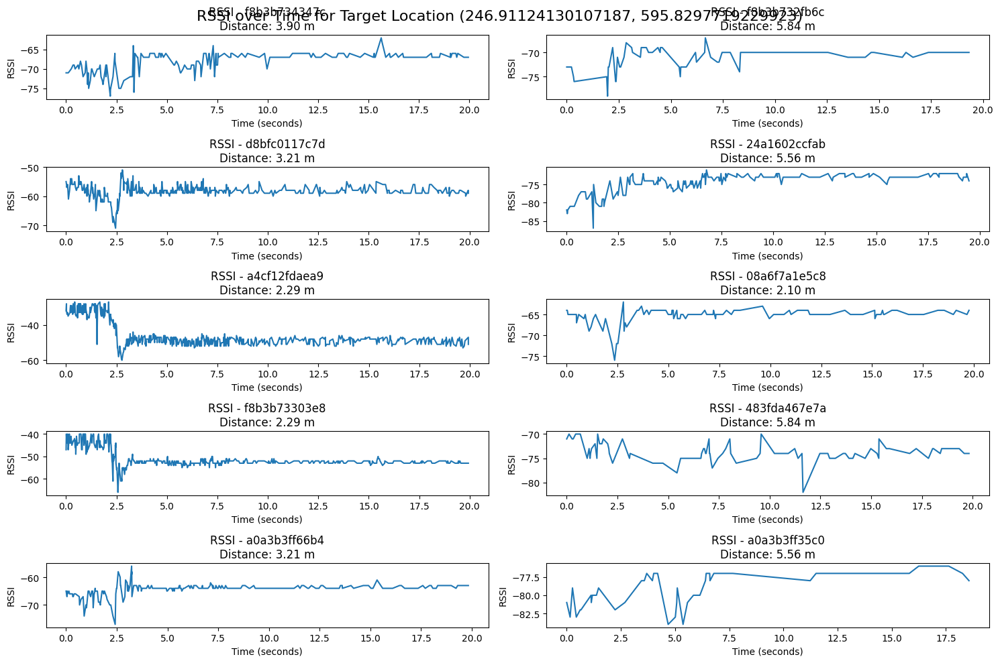

...

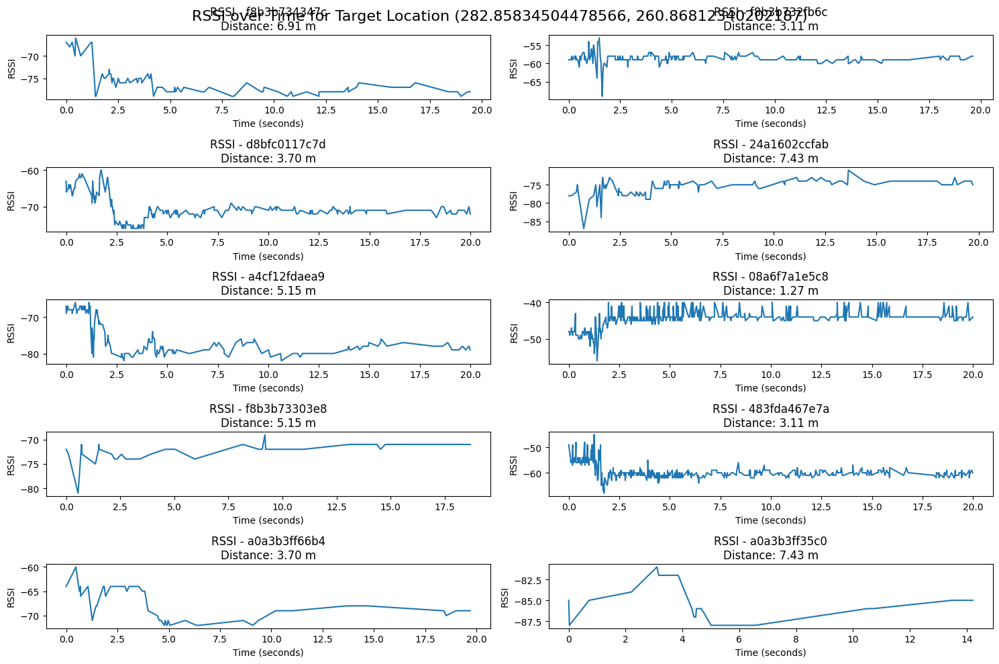

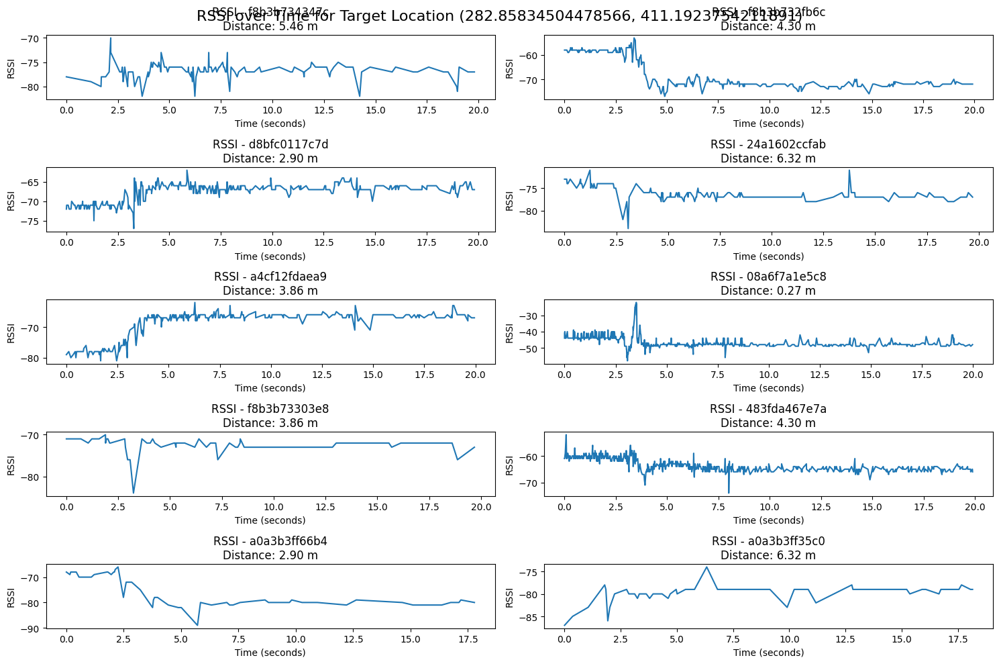

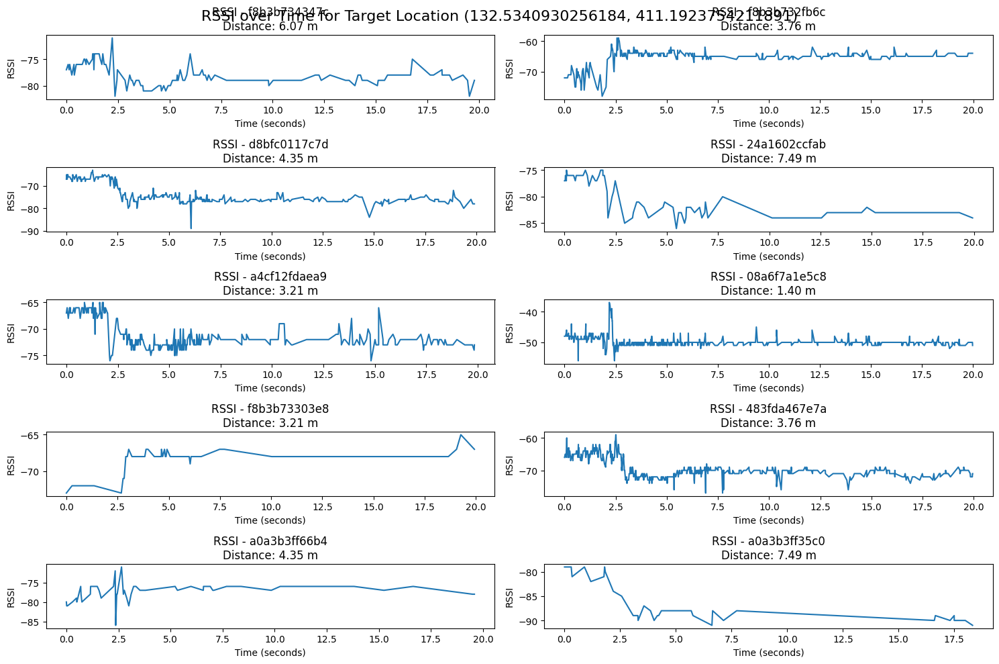

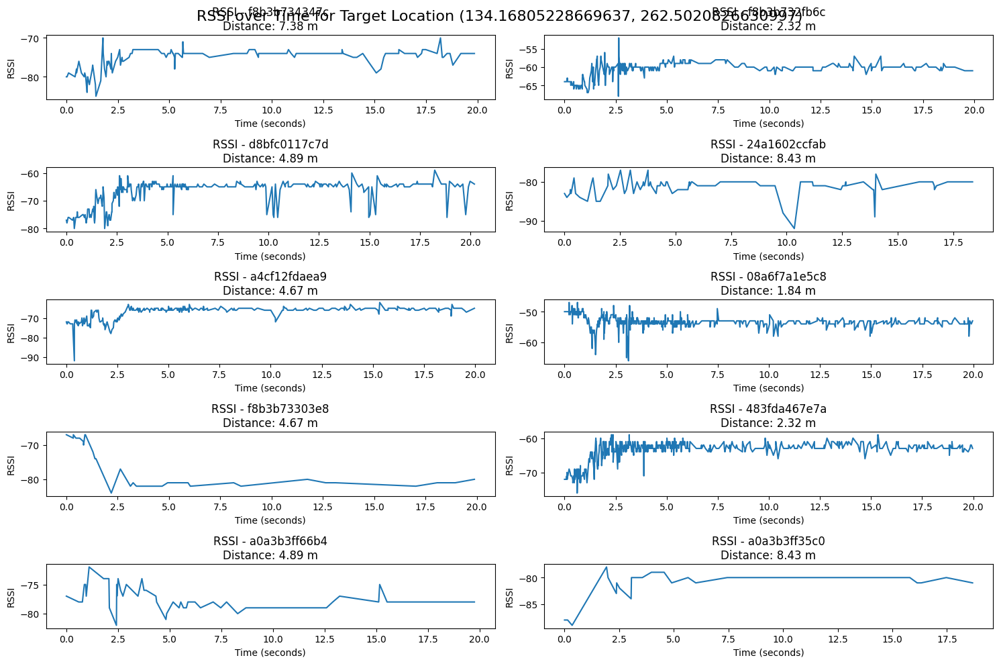

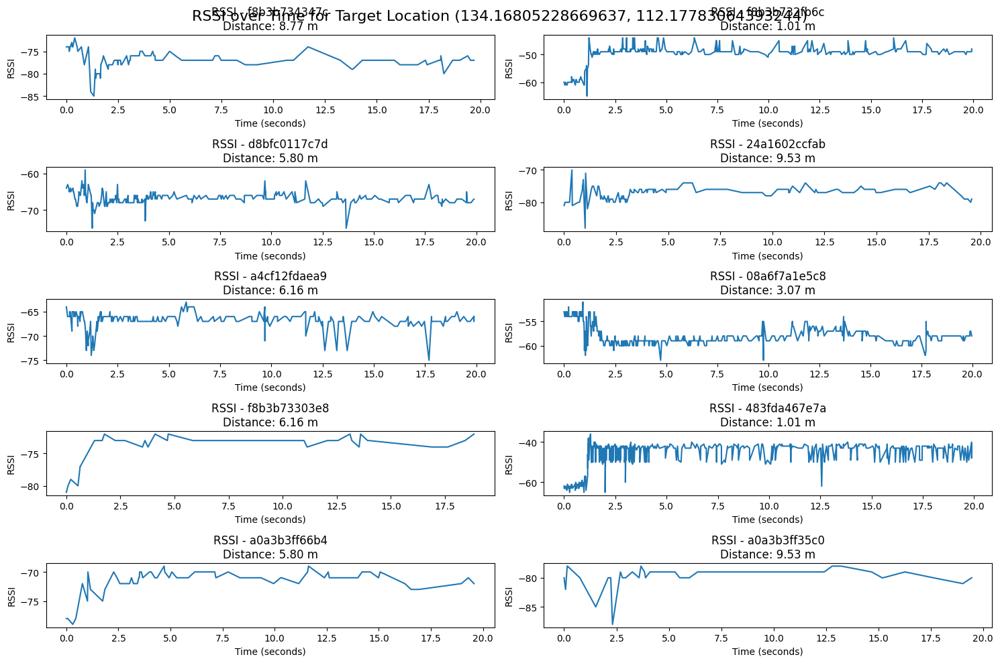

In [114]:
plot_rssi_over_time("./data/filtered/flat/Pixel9.csv")

## Error Metrics

### User Range Error

In [180]:
import numpy as np
import pandas as pd

def rssi_to_distance(rssi, rssi_0=-50, n=2):
    """
    Convert RSSI value to distance using the inverse path loss model.
    
    Parameters:
    - rssi (float): The RSSI value in dBm.
    - rssi_0 (float): RSSI at reference distance (default is -50 dBm at 1 meter).
    - n (float): Path loss exponent (default is 2).
    
    Returns:
    - distance (float): The estimated distance in meters.
    """
    return 10 ** ((rssi_0 - rssi) / (10 * n))

def get_relevant_anchor_stats(anchor_stats, rssis):
        monitor_macs_intersec = anchor_stats.keys() & rssis.keys()
        anchor_stats_intersec = [anchor_stats[monitor_mac] for monitor_mac in monitor_macs_intersec]
        rssis_intersec = [rssis[monitor_mac] for monitor_mac in monitor_macs_intersec]
        
        return monitor_macs_intersec, anchor_stats_intersec, rssis_intersec

def localize(rssis, anchor_positions, path_loss_params):
    relevant_monitor_macs, relevant_positions, relevant_rssis = get_relevant_anchor_stats(anchor_positions, rssis)
    relevant_distances = [rssi_to_distance(rssi, path_loss_params['rssi_0'], path_loss_params['n']) * 100.0 for rssi in relevant_rssis] # m to cm

    print(relevant_distances)

    # Number of known positions
    n = len(relevant_positions)
    
    # Build the A matrix and b vector
    A = []
    b = []
    
    x_n, y_n = relevant_positions[n-1]
    d_n = relevant_distances[n-1]
    for i in range(n - 1):
        x_i, y_i = relevant_positions[i]
        d_i = relevant_distances[i]
        A.append([2*(x_i - x_n), 2*(y_i - y_n)])
        b.append(x_i**2 + y_i**2 - x_n**2 - y_n**2 - d_i**2 + d_n**2)
    A = np.array(A)
    b = np.array(b)

    # Compute the least squares solution using the normal equation: x = (A^T A)^(-1) A^T b
    position, residuals, rank, s = np.linalg.lstsq(A, b, rcond=None)
    
    return {
        'position': position,
        'distances': {monitor_mac: distance for monitor_mac, distance in zip(relevant_monitor_macs, relevant_distances)}
    }

def estimate_positions(csv_file, monitor_mac_col, target_mac_col, timestamp_col, rssi_col, target_position_x_col, target_position_y_col, anchor_position_x_col, anchor_position_y_col, path_loss_params=None):
    """
    Estimate the positions of the target devices based on RSSI values and multilateration.
    
    Parameters:
    - csv_file (str): Path to the CSV file.
    - monitor_mac_col (str): Column name for monitor MAC addresses.
    - target_mac_col (str): Column name for target MAC addresses.
    - timestamp_col (str): Column name for timestamp.
    - rssi_col (str): Column name for RSSI values.
    - target_position_x_col (str): Column name for target position X.
    - target_position_y_col (str): Column name for target position Y.
    - anchor_position_x_col (str): Column name for anchor position X.
    - anchor_position_y_col (str): Column name for anchor position Y.
    - path_loss_params (dict): Dictionary with the path loss model parameters ('rssi_0', 'n').
    
    Returns:
    - position_errors (list of float): List of errors (distances between estimated and ground truth positions).
    """
    df = pd.read_csv(csv_file)
    
    anchor_positions = df[[monitor_mac_col, anchor_position_x_col, anchor_position_y_col]].drop_duplicates().set_index(monitor_mac_col).apply(
        lambda row: (row[anchor_position_x_col], row[anchor_position_y_col]), axis=1
    ).to_dict()

    # Default path loss parameters
    if path_loss_params is None:
        path_loss_params = {'rssi_0': -50, 'n': 2}
    
    position_errors = []
    
    for target_mac, target_position_x, target_position_y in df[[target_mac_col, target_position_x_col, target_position_y_col]].drop_duplicates().values:
        # Filter the data for the current target
        target_data = df[(df[target_mac_col] == target_mac) & 
                         (df[target_position_x_col] == target_position_x) &
                         (df[target_position_y_col] == target_position_y)]

        # Get the median RSSI per monitor node
        median_rssi_dict = target_data.groupby(monitor_mac_col)[rssi_col].median().to_dict()
        
        # Perform multilateration
        localization_result = localize(median_rssi_dict, anchor_positions, path_loss_params)
        estimated_position = localization_result['position']

        print(estimated_position)
        print((target_position_x, target_position_y))

        error = np.sqrt((estimated_position[0] - target_position_x)**2 + (estimated_position[1] - target_position_y)**2)
        position_errors.append(error)
    
    return position_errors


In [181]:
csv_file = "./data/filtered/apb/Pixel9.csv"  # Path to your CSV file
monitor_mac_column = "monitor_mac"
target_mac_column = "target_mac"
timestamp_column = "timestamp"
rssi_column = "rssi"
target_position_x_column = "target_position_x"
target_position_y_column = "target_position_y"
anchor_position_x_column = "anchor_position_x"
anchor_position_y_column = "anchor_position_y"

# Call the function to estimate positions and calculate errors
errors = np.array(estimate_positions(csv_file, monitor_mac_column, target_mac_column, timestamp_column, rssi_column, 
                            target_position_x_column, target_position_y_column, anchor_position_x_column, 
                            anchor_position_y_column)) / 100.0 # convert to meters

# Print the position errors for each target location
print("Position errors (in meters):")
print(errors)

[158.48931924611136, 158.48931924611136, 446.6835921509632, 5011.872336272722, 1412.537544622754, 5623.413251903491, 3548.133892335755, 446.6835921509632, 446.6835921509632]
[ 1808.13690793 -7767.25034469]
(1338.2911924263376, 94.04738857568329)
[100.0, 141.25375446227542, 354.8133892335755, 891.2509381337454, 4466.83592150963, 354.8133892335755, 446.6835921509632]
[ 5978.18365552 -2765.617003  ]
(1338.2911924263376, 290.78177853419834)
[316.22776601683796, 223.87211385683395, 281.83829312644536, 2985.3826189179604, 891.2509381337454, 1883.6490894898002, 158.48931924611136, 251.188643150958]
[   58.68696525 -1036.3072494 ]
(1336.855174981385, 490.3882033826187)
[354.8133892335755, 177.82794100389228, 316.22776601683796, 5011.872336272722, 421.6965034285822, 2818.3829312644534, 158.48931924611136, 354.8133892335755]
[-2203.5266054  -3486.50246419]
(1138.6847675779172, 493.260238272524)
[223.87211385683395, 446.6835921509632, 158.48931924611136, 7498.942093324558, 707.9457843841378, 3981

In [187]:
from scipy.optimize import minimize

# Objective function for optimization (RMSE minimization)
def objective_function(params, csv_file, monitor_mac_col, target_mac_col, timestamp_col, rssi_col, 
                       target_position_x_col, target_position_y_col, anchor_position_x_col, anchor_position_y_col):
    """
    Objective function to minimize RMSE by adjusting the path loss model parameters.
    
    Parameters:
    - params (list): Path loss model parameters [rssi_0, n].
    - csv_file (str): Path to the CSV file.
    - monitor_mac_col (str): Column name for monitor MAC addresses.
    - target_mac_col (str): Column name for target MAC addresses.
    - timestamp_col (str): Column name for timestamp.
    - rssi_col (str): Column name for RSSI values.
    - target_position_x_col (str): Column name for target position X.
    - target_position_y_col (str): Column name for target position Y.
    - anchor_position_x_col (str): Column name for anchor position X.
    - anchor_position_y_col (str): Column name for anchor position Y.
    
    Returns:
    - rmse (float): Root mean square error for the estimated positions.
    """
    rssi_0, n = params  # Unpack parameters
    path_loss_params = {'rssi_0': rssi_0, 'n': n}
    position_errors = estimate_positions(csv_file, monitor_mac_col, target_mac_col, timestamp_col, rssi_col, 
                                         target_position_x_col, target_position_y_col, anchor_position_x_col, 
                                         anchor_position_y_col, path_loss_params)

    print(position_errors)

    rmse = np.sqrt(np.mean(np.array(position_errors)**2))
    return rmse

# Optimizing the path loss model parameters with bounds
def optimize_path_loss_params(csv_file, monitor_mac_col, target_mac_col, timestamp_col, rssi_col, 
                              target_position_x_col, target_position_y_col, anchor_position_x_col, 
                              anchor_position_y_col):
    """
    Optimize the path loss model parameters (rssi_0 and n) using RMSE minimization with bounds.
    
    Parameters:
    - csv_file (str): Path to the CSV file.
    - monitor_mac_col (str): Column name for monitor MAC addresses.
    - target_mac_col (str): Column name for target MAC addresses.
    - timestamp_col (str): Column name for timestamp.
    - rssi_col (str): Column name for RSSI values.
    - target_position_x_col (str): Column name for target position X.
    - target_position_y_col (str): Column name for target position Y.
    - anchor_position_x_col (str): Column name for anchor position X.
    - anchor_position_y_col (str): Column name for anchor position Y.
    
    Returns:
    - result (dict): Dictionary with optimized parameters and minimized RMSE.
    """
    # Set bounds for the parameters: rssi_0 between -80 dBm and -30 dBm, n between 1.5 and 4
    bounds = [(-80, -10), (1.5, 6)]
    
    initial_guess = [-50, 2]  # Initial guess for rssi_0 and n
    result = minimize(objective_function, initial_guess, args=(csv_file, monitor_mac_col, target_mac_col, 
                                                               timestamp_col, rssi_col, target_position_x_col, 
                                                               target_position_y_col, anchor_position_x_col, 
                                                               anchor_position_y_col), method='Nelder-Mead', bounds=bounds)
    
    optimized_rssi_0, optimized_n = result.x
    minimized_rmse = result.fun
    
    return {
        'optimized_rssi_0': optimized_rssi_0,
        'optimized_n': optimized_n,
        'minimized_rmse': minimized_rmse
    }

In [188]:
optimize_path_loss_params(csv_file, monitor_mac_column, target_mac_column, timestamp_column, rssi_column, 
                            target_position_x_column, target_position_y_column, anchor_position_x_column, 
                            anchor_position_y_column)

[158.48931924611136, 158.48931924611136, 446.6835921509632, 5011.872336272722, 1412.537544622754, 5623.413251903491, 3548.133892335755, 446.6835921509632, 446.6835921509632]
[ 1808.13690793 -7767.25034469]
(1338.2911924263376, 94.04738857568329)
[100.0, 141.25375446227542, 354.8133892335755, 891.2509381337454, 4466.83592150963, 354.8133892335755, 446.6835921509632]
[ 5978.18365552 -2765.617003  ]
(1338.2911924263376, 290.78177853419834)
[316.22776601683796, 223.87211385683395, 281.83829312644536, 2985.3826189179604, 891.2509381337454, 1883.6490894898002, 158.48931924611136, 251.188643150958]
[   58.68696525 -1036.3072494 ]
(1336.855174981385, 490.3882033826187)
[354.8133892335755, 177.82794100389228, 316.22776601683796, 5011.872336272722, 421.6965034285822, 2818.3829312644534, 158.48931924611136, 354.8133892335755]
[-2203.5266054  -3486.50246419]
(1138.6847675779172, 493.260238272524)
[223.87211385683395, 446.6835921509632, 158.48931924611136, 7498.942093324558, 707.9457843841378, 3981

{'optimized_rssi_0': -26.703493725441394,
 'optimized_n': 6.0,
 'minimized_rmse': 500.4968230572758}

In [183]:
objective_function([-50, 2], csv_file, monitor_mac_column, target_mac_column, 
                                                               timestamp_column, rssi_column, target_position_x_column, 
                                                               target_position_y_column, anchor_position_x_column, 
                                                               anchor_position_y_column)

[158.48931924611136, 158.48931924611136, 446.6835921509632, 5011.872336272722, 1412.537544622754, 5623.413251903491, 3548.133892335755, 446.6835921509632, 446.6835921509632]
[ 1808.13690793 -7767.25034469]
(1338.2911924263376, 94.04738857568329)
[100.0, 141.25375446227542, 354.8133892335755, 891.2509381337454, 4466.83592150963, 354.8133892335755, 446.6835921509632]
[ 5978.18365552 -2765.617003  ]
(1338.2911924263376, 290.78177853419834)
[316.22776601683796, 223.87211385683395, 281.83829312644536, 2985.3826189179604, 891.2509381337454, 1883.6490894898002, 158.48931924611136, 251.188643150958]
[   58.68696525 -1036.3072494 ]
(1336.855174981385, 490.3882033826187)
[354.8133892335755, 177.82794100389228, 316.22776601683796, 5011.872336272722, 421.6965034285822, 2818.3829312644534, 158.48931924611136, 354.8133892335755]
[-2203.5266054  -3486.50246419]
(1138.6847675779172, 493.260238272524)
[223.87211385683395, 446.6835921509632, 158.48931924611136, 7498.942093324558, 707.9457843841378, 3981

9693.799973308485

In [1]:
from abc import ABC, abstractmethod
import numpy as np
import pandas as pd
from scipy.interpolate import Rbf

def inverse_path_loss_model(rssi, rssi_0, n):
    distance = pow(10, ((rssi_0 - rssi) / (10.0 * n)))
    return distance

class AbstractLocalization(ABC):

    def __init__(self):
        pass

    @abstractmethod
    def localize(self, rssis):
        pass
    
    def get_relevant_anchor_stats(self, anchor_stats, rssis):
        monitor_macs_intersec = anchor_stats.keys() & rssis.keys()
        anchor_stats_intersec = [anchor_stats[monitor_mac] for monitor_mac in monitor_macs_intersec]
        rssis_intersec = [rssis[monitor_mac] for monitor_mac in monitor_macs_intersec]
        
        return monitor_macs_intersec, anchor_stats_intersec, rssis_intersec

class TrilaterationLeastSquaresLocalization(AbstractLocalization):
    def __init__(self, anchor_positions, monitor_model_params):
        super().__init__()
        
        self.anchor_positions = anchor_positions
        self.monitor_model_params = monitor_model_params
    
    def localize(self, rssis):
        relevant_monitor_macs, relevant_positions, relevant_rssis = self.get_relevant_anchor_stats(self.anchor_positions, rssis)
        relevant_distances = [inverse_path_loss_model(rssi, self.monitor_model_params[monitor_mac][0], self.monitor_model_params[monitor_mac][1]) * 100.0 for rssi, monitor_mac in zip(relevant_rssis, relevant_monitor_macs)] # m to cm

        print("rssis:")
        print(relevant_rssis)
        print("distances:")
        print(relevant_distances)
        
        # Number of known positions
        n = len(relevant_positions)
        
        # Build the A matrix and b vector
        A = []
        b = []
        
        x_n, y_n = relevant_positions[n-1]
        d_n = relevant_distances[n-1]
        for i in range(n - 1):
            x_i, y_i = relevant_positions[i]
            d_i = relevant_distances[i]
            A.append([2*(x_i - x_n), 2*(y_i - y_n)])
            b.append(x_i**2 + y_i**2 - x_n**2 - y_n**2 - d_i**2 + d_n**2)
        A = np.array(A)
        b = np.array(b)

        # Compute the least squares solution using the normal equation: x = (A^T A)^(-1) A^T b
        position, residuals, rank, s = np.linalg.lstsq(A, b, rcond=None)
        
        return {
            'position': position,
            'distances': {monitor_mac: distance for monitor_mac, distance in zip(relevant_monitor_macs, relevant_distances)}
        }

class TrilaterationWeightedCentroidLocalization(AbstractLocalization):
    def __init__(self, anchor_positions, rssi_0, n):
        super().__init__()
        
        self.anchor_positions = anchor_positions
        self.rssi_0 = rssi_0
        self.n = n
    
    def localize(self, rssis):
        relevant_monitor_macs, relevant_positions, relevant_rssis = self.get_relevant_anchor_stats(self.anchor_positions, rssis)
        relevant_distances = [inverse_path_loss_model(rssi, self.rssi_0, self.n) * 100.0 for rssi in relevant_rssis] # m to cm
        
        relevant_positions_np = np.array(relevant_positions)
        distances_np = np.array(relevant_distances)
        
        # Calculate the weights as the inverse of the distances
        weights = 1.0 / distances_np
        
        # Normalize the weights so they sum up to 1
        weights /= np.sum(weights)
        
        # Weighted sum of positions
        x = np.sum([w * pos[0] for w, pos in zip(weights, relevant_positions_np)])
        y = np.sum([w * pos[1] for w, pos in zip(weights, relevant_positions_np)])
        
        position = (x, y)
        
        return {
            'position': position,
            'distances': {monitor_mac: distance for monitor_mac, distance in zip(relevant_monitor_macs, relevant_distances)}
        }

class FingerprintingLocalization(AbstractLocalization):
    def __init__(self, fingerprints_file_path, background_size, heatmap_resolution=5.0): # every 5cm
        super().__init__()
        
        x = np.arange(0, background_size[0], heatmap_resolution)
        y = np.arange(0, background_size[1], heatmap_resolution)
        self.pos_lookup_x = np.append(x, background_size[0]) # include boundary
        self.pos_lookup_y = np.append(y, background_size[1])
        num_x = len(self.pos_lookup_x)
        num_y = len(self.pos_lookup_y)
            
        gx, gy = np.meshgrid(self.pos_lookup_x, self.pos_lookup_y)
        gx, gy = gx.flatten(), gy.flatten()
        
        
        df = pd.read_csv(fingerprints_file_path, index_col=False)
        df_mean = df.groupby(['monitor_mac', 'target_position_x', 'target_position_y', 'anchor_position_x', 'anchor_position_y'], as_index=False).agg({'rssi':['median']})
        df_mean.columns = ['monitor_mac', 'target_position_x', 'target_position_y', 'anchor_position_x', 'anchor_position_y', 'rssi_median']
        
        def generate_interpolated_fingerprint_map(monitor_mac):
            monitor_rows = df_mean[df_mean['monitor_mac'] == monitor_mac]
            
            target_positions_x = monitor_rows['target_position_x'].to_list()
            target_positions_y = monitor_rows['target_position_y'].to_list()
            rssi_medians = monitor_rows['rssi_median'].to_list()
            
            
            # from https://github.com/jantman/python-wifi-survey-heatmap/blob/master/wifi_survey_heatmap/heatmap.py
            
            rbf = Rbf(target_positions_x, target_positions_y, rssi_medians, function='linear')
            z = rbf(gx, gy)
            z = z.reshape((num_y, num_x))
            
            return z
        
        monitor_macs = df_mean['monitor_mac'].unique()
        self.interpolated_fingerprints = {monitor_mac: generate_interpolated_fingerprint_map(monitor_mac) for monitor_mac in monitor_macs}
    
    def localize(self, rssis):
        _, relevant_interpolated_fingerprints, relevant_rssis = self.get_relevant_anchor_stats(self.interpolated_fingerprints, rssis)
        
        diff = np.moveaxis(relevant_interpolated_fingerprints, 0, -1) - relevant_rssis        
        norm = np.linalg.norm(diff, axis=2)
        min_pos_heatmap = np.unravel_index(np.argmin(norm, axis=None), norm.shape)        
        min_pos = (self.pos_lookup_x[min_pos_heatmap[1]], self.pos_lookup_y[min_pos_heatmap[0]])
        
        position = min_pos
        
        return {
            'position': position,
            'heatmap': norm
        }

In [2]:
def estimate_positions(df, monitor_model_params):    
    anchor_positions = df[["monitor_mac", "anchor_position_x", "anchor_position_y"]].drop_duplicates().set_index("monitor_mac").apply(
        lambda row: (row["anchor_position_x"], row["anchor_position_y"]), axis=1
    ).to_dict()

    tri_alg = TrilaterationLeastSquaresLocalization(anchor_positions, monitor_model_params)
    
    position_errors = []
    
    for target_mac, target_position_x, target_position_y in df[["target_mac", "target_position_x", "target_position_y"]].drop_duplicates().values:
        # Filter the data for the current target
        target_data = df[(df["target_mac"] == target_mac) & 
                         (df["target_position_x"] == target_position_x) &
                         (df["target_position_y"] == target_position_y)]

        # Get the median RSSI per monitor node
        median_rssi_dict = target_data.groupby("monitor_mac")["rssi"].median().to_dict()
        
        # Perform multilateration
        localization_result = tri_alg.localize(median_rssi_dict)
        estimated_position = localization_result['position']

        print(estimated_position)
        print((target_position_x, target_position_y))

        error = np.sqrt((estimated_position[0] - target_position_x)**2 + (estimated_position[1] - target_position_y)**2)
        position_errors.append(error)
    
    return position_errors


In [3]:
from scipy.optimize import minimize

# Objective function for optimization (RMSE minimization)
def objective_function(params, df):
    monitor_macs = df["monitor_mac"].unique()

    monitor_model_params = {}
    if len(params) >= 2 * len(monitor_macs):
        for idx, monitor_mac in enumerate(monitor_macs):
            monitor_model_params[monitor_mac] = (params[idx * 2], params[idx * 2 + 1])
    else:
        monitor_model_params = {monitor_mac: (params[0], params[1]) for monitor_mac in monitor_macs}

    position_errors = estimate_positions(df, monitor_model_params)

    print(position_errors)

    rmse = np.sqrt(np.mean(np.array(position_errors)**2))
    return rmse

# Optimizing the path loss model parameters with bounds
def optimize_path_loss_params(df):
    # Set bounds for the parameters: rssi_0 between -80 dBm and -30 dBm, n between 1.5 and 4
    bounds = [(-80, -10), (1.5, 6)]
    
    initial_guess = [-50, 2]  # Initial guess for rssi_0 and n
    result = minimize(objective_function, initial_guess, args=(df), method='Nelder-Mead', bounds=bounds)
    
    optimized_rssi_0, optimized_n = result.x
    minimized_rmse = result.fun
    
    return {
        'optimized_rssi_0': optimized_rssi_0,
        'optimized_n': optimized_n,
        'minimized_rmse': minimized_rmse
    }

# Optimizing the path loss model parameters with bounds of multiple monitors
def optimize_path_loss_params_multiple(df):
    initial_guess = []
    bounds = []
    for _ in df["monitor_mac"].unique():
        # Initial guess for rssi_0 and n
        initial_guess.append(-50)
        initial_guess.append(2)

        bounds.append((-80, -10))
        bounds.append((1.5, 6))

    result = minimize(objective_function, initial_guess, args=(df), method='Nelder-Mead', bounds=bounds)
    
    optimized_rssi_0, optimized_n = result.x
    minimized_rmse = result.fun
    
    return {
        'optimized_rssi_0': optimized_rssi_0,
        'optimized_n': optimized_n,
        'minimized_rmse': minimized_rmse
    }

In [4]:
df = pd.read_csv("./data/filtered/apb/Pixel9.csv")
monitor_model_params = {monitor_mac: (-50, 2) for monitor_mac in df["monitor_mac"].unique()}
estimate_positions(df, monitor_model_params)

rssis:
[-81.0, -63.0, -73.0, -63.0, -85.0, -63.0, -54.0, -84.0, -54.0]
distances:
[3548.133892335755, 446.6835921509632, 1412.537544622754, 446.6835921509632, 5623.413251903491, 446.6835921509632, 158.48931924611136, 5011.872336272722, 158.48931924611136]
[  1099.79422646 -11015.15533572]
(1338.2911924263376, 94.04738857568329)
rssis:
[-61.0, -69.0, -83.0, -63.0, -61.0, -53.0, -50.0]
distances:
[354.8133892335755, 891.2509381337454, 4466.83592150963, 446.6835921509632, 354.8133892335755, 141.25375446227542, 100.0]
[5139.62424297 -112.43836981]
(1338.2911924263376, 290.78177853419834)
rssis:
[-54.0, -69.0, -75.5, -58.0, -59.0, -57.0, -79.5, -60.0]
distances:
[158.48931924611136, 891.2509381337454, 1883.6490894898002, 251.188643150958, 281.83829312644536, 223.87211385683395, 2985.3826189179604, 316.22776601683796]
[  -25.80097984 -2701.8023828 ]
(1336.855174981385, 490.3882033826187)
rssis:
[-54.0, -62.5, -79.0, -61.0, -60.0, -55.0, -84.0, -61.0]
distances:
[158.48931924611136, 421.69650

[11111.76250521261,
 3822.658688550462,
 3470.866251356168,
 9773.270745402726,
 22332.762410671596,
 3619.6333039469464,
 49803.50524843631,
 13379.179496768402,
 7720.466028496003,
 4703.534232553672,
 12075.910064636551,
 4182.884645550717,
 2860.762146066382,
 2094.7922877502524,
 553.4498426897692,
 1405.3800197357345,
 4510.52199537295,
 6711.486389895122,
 8367.15393292984,
 11149.322757491045,
 1629.9962308372305,
 11216.873401087218,
 15120.988976017112]

In [5]:
df = pd.read_csv("./data/filtered/apb/Pixel9.csv")
optimize_path_loss_params(df)

rssis:
[-81.0, -63.0, -73.0, -63.0, -85.0, -63.0, -54.0, -84.0, -54.0]
distances:
[3548.133892335755, 446.6835921509632, 1412.537544622754, 446.6835921509632, 5623.413251903491, 446.6835921509632, 158.48931924611136, 5011.872336272722, 158.48931924611136]
[  1099.79422646 -11015.15533572]
(1338.2911924263376, 94.04738857568329)
rssis:
[-61.0, -69.0, -83.0, -63.0, -61.0, -53.0, -50.0]
distances:
[354.8133892335755, 891.2509381337454, 4466.83592150963, 446.6835921509632, 354.8133892335755, 141.25375446227542, 100.0]
[5139.62424297 -112.43836981]
(1338.2911924263376, 290.78177853419834)
rssis:
[-54.0, -69.0, -75.5, -58.0, -59.0, -57.0, -79.5, -60.0]
distances:
[158.48931924611136, 891.2509381337454, 1883.6490894898002, 251.188643150958, 281.83829312644536, 223.87211385683395, 2985.3826189179604, 316.22776601683796]
[  -25.80097984 -2701.8023828 ]
(1336.855174981385, 490.3882033826187)
rssis:
[-54.0, -62.5, -79.0, -61.0, -60.0, -55.0, -84.0, -61.0]
distances:
[158.48931924611136, 421.69650

{'optimized_rssi_0': -67.2757326659274,
 'optimized_n': 2.1019642839173227,
 'minimized_rmse': 530.5058286142414}

In [6]:
df = pd.read_csv("./data/filtered/apb/Pixel9.csv")
optimize_path_loss_params_multiple(df)

In [13]:
def prep_data(df):
    # Merge coordinates into single columns
    df["anchor_position"] = list(zip(df["anchor_position_x"], df["anchor_position_y"]))
    df["target_position"] = list(zip(df["target_position_x"], df["target_position_y"]))

    # Round the coordinates in the anchor_position and target_position columns
    df["anchor_position"] = df["anchor_position"].apply(lambda pos: (round(pos[0]), round(pos[1])))
    df["target_position"] = df["target_position"].apply(lambda pos: (round(pos[0]), round(pos[1])))

    # Drop the original coordinate columns if no longer needed
    df.drop(columns=["anchor_position_x", "anchor_position_y", "target_position_x", "target_position_y"], inplace=True)

    # Group by monitor_mac and target_position, and calculate the median RSSI
    df_median_rssi = (
        df.groupby(["target_position", "target_mac", "monitor_mac", "anchor_position"], as_index=False)
        .agg({"rssi": "median"})
    )

    return df_median_rssi

In [14]:
# fingerprint data
df_fingerprint_pixel9 = prep_data(pd.read_csv("./data/filtered/flat/Pixel9.csv"))
df_fingerprint_p20 = prep_data(pd.read_csv("./data/filtered/flat/P20_Pro.csv"))
df_fingerprint_iphone = prep_data(pd.read_csv("./data/filtered/flat/iPhone.csv"))

df_fingerprint_median = pd.concat([df_fingerprint_pixel9, df_fingerprint_p20, df_fingerprint_iphone]).reset_index()

# eval data
df_eval_pixel9 = prep_data(pd.read_csv("./data/filtered/flat/Pixel9_eval.csv"))
df_eval_p20 = prep_data(pd.read_csv("./data/filtered/flat/P20_Pro_eval.csv"))
df_eval_iphone = prep_data(pd.read_csv("./data/filtered/flat/iPhone_eval.csv"))

df_eval_median = pd.concat([df_eval_pixel9, df_eval_p20, df_eval_iphone]).reset_index()
df_eval_median

,index,target_position,target_mac,monitor_mac,anchor_position,rssi
0,0,"(101, 656)",20f094118214,08a6f7a1e5c8,"(270, 387)",-73.0
1,1,"(101, 656)",20f094118214,24a1602ccfab,"(744, 844)",-79.0
2,2,"(101, 656)",20f094118214,483fda467e7a,"(62, 42)",-76.0
3,3,"(101, 656)",20f094118214,a0a3b3ff35c0,"(744, 844)",-81.0
4,4,"(101, 656)",20f094118214,a0a3b3ff66b4,"(556, 510)",-60.0
...,...,...,...,...,...,...
516,175,"(701, 542)",d81c79de34e1,a4cf12fdaea9,"(56, 723)",-68.0
517,176,"(701, 542)",d81c79de34e1,d8bfc0117c7d,"(556, 510)",-49.0
518,177,"(701, 542)",d81c79de34e1,f8b3b732fb6c,"(62, 42)",-81.0
519,178,"(701, 542)",d81c79de34e1,f8b3b73303e8,"(56, 723)",-67.0


In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

monitor_groups = [
    ["483fda467e7a", "f8b3b732fb6c"],
    ["d8bfc0117c7d", "a0a3b3ff66b4"],
    ["24a1602ccfab", "a0a3b3ff35c0"],
    ["a4cf12fdaea9", "f8b3b73303e8"],
    ["f8b3b734347c"],
    ["08a6f7a1e5c8"]
]

# Log-distance path loss model
def log_distance_model(d, rssi_0, n):
    return rssi_0 - 10 * n * np.log10(d)

# right now only works for APB
def classify_target_location(coordinates):
    rect_x_min = 780
    rect_x_max = 1520
    rect_y_min = 0
    rect_y_max = 665

    if rect_x_min <= coordinates[0] <= rect_x_max and rect_y_min <= coordinates[1] <= rect_y_max:
        return "inside"
    else:
        return "outside"

def get_distance_and_classify(df):
    df_distances = df.copy()

    # Add the "class" column
    df_distances["class"] = df_distances["target_position"].apply(classify_target_location)

    # Add the "distance" column
    df_distances["distance"] = df_distances.apply(
        # Function to calculate the Euclidean distance# Function to calculate the Euclidean distance
        lambda row: np.linalg.norm(np.array(row["target_position"]) - np.array(row["anchor_position"])) / 100.0, axis=1
    )

    return df_distances

def fit_path_loss_model(df_distances):
    # Function to fit the data and return the parameters
    def fit_group(group):
        distances = group["distance"].values
        rssis = group["rssi"].values

        # Fit the function to the data
        popt, _ = curve_fit(log_distance_model, distances, rssis, p0=(-50, 2))
        return pd.Series({"rssi_0": popt[0], "n": popt[1]})

    return df_distances[df_distances["distance"] > 0].groupby(["target_mac", "monitor_mac"]).apply(fit_group).reset_index()

def plot_rssi_vs_distance(df_distances, df_model_params, group=True):
    global target_macs

    grouping = monitor_groups if group else [[monitor_mac] for monitor_mac in df_distances["monitor_mac"].unique()]

    # Define marker shapes for the classes
    marker_styles = {"inside": "x", "outside": "o"}
    
    # Iterate over each group of monitor MACs
    for group_index, monitor_group in enumerate(grouping):
        # Create a figure with enough space for all subplots
        fig, axs = plt.subplots(1, len(df_distances["target_mac"].unique()), figsize=(18, 6), sharey=True)
        
        # Set the figure title for the current group
        fig.suptitle(f"RSSI vs. Distance for Group {group_index + 1}", fontsize=16)

        # Collect handles and labels for the legend
        all_handles, all_labels = [], []

        for target_idx, target_mac in enumerate(target_macs):
            df_target = df_distances[df_distances["target_mac"] == target_mac]
            df_target_params = df_model_params[df_model_params["target_mac"] == target_mac]

            ax = axs[target_idx]  # Get the subplot for this target_mac
        
            for monitor_idx, monitor_mac in enumerate(monitor_group):
                df_monitor = df_target[df_target["monitor_mac"] == monitor_mac]
                df_monitor_params = df_target_params[df_target_params["monitor_mac"] == monitor_mac]

                # Scatter plot with marker styles based on classes
                for target_class in df_monitor["class"].unique():
                    df_class = df_monitor[df_monitor["class"] == target_class]
                    scatter = ax.scatter(
                            df_class["distance"], 
                            df_class["rssi"], 
                            label=f'Monitor {monitor_mac} ({target_class})', 
                            marker=marker_styles[target_class],
                            color=plt.cm.tab10(monitor_idx),
                            alpha=0.7
                        )

                    # Collect handles and labels only if not already added
                    if f'Monitor {monitor_mac} ({target_class})' not in all_labels:
                        all_handles.append(scatter)
                        all_labels.append(f'Monitor {monitor_mac} ({target_class})')

                if len(df_monitor_params.index) > 0:
                    rssi_0 = df_monitor_params["rssi_0"].item()
                    n = df_monitor_params["n"].item()
                        
                    # Generate fit line
                    fit_distances = np.linspace(df_monitor["distance"].min(), df_monitor["distance"].max(), 500)
                    fit_rssis = log_distance_model(fit_distances, rssi_0, n)
                        
                    # Plot the fit
                    (line_handle, ) = ax.plot(fit_distances, fit_rssis, label=f'Fit {monitor_mac}', linestyle='--')

                    # Collect handles and labels only if not already added
                    if f'Fit {monitor_mac}' not in all_labels:
                        all_handles.append(line_handle)
                        all_labels.append(f'Fit {monitor_mac}')
        
            # Customize the plot
            ax.set_title(f"Target: {device_names[target_mac]}")
            ax.set_xlabel("Distance (m)")
            ax.set_ylabel("Median RSSI")
            ax.grid(True)
        
        # Add a shared legend above the subplots
        fig.legend(
            all_handles,
            all_labels,
            loc='upper right',  # Anchor the legend to its top-right corner
            ncol=1,             # Single column legend
            fontsize='small',
            bbox_to_anchor=(0.99, 0.88),  # Adjust these values for precise alignment
        )

        fig.tight_layout()
        plt.show()

Fingerprint:


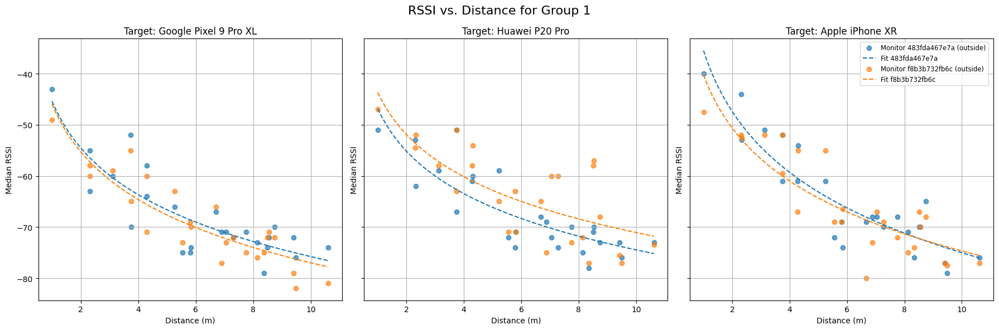

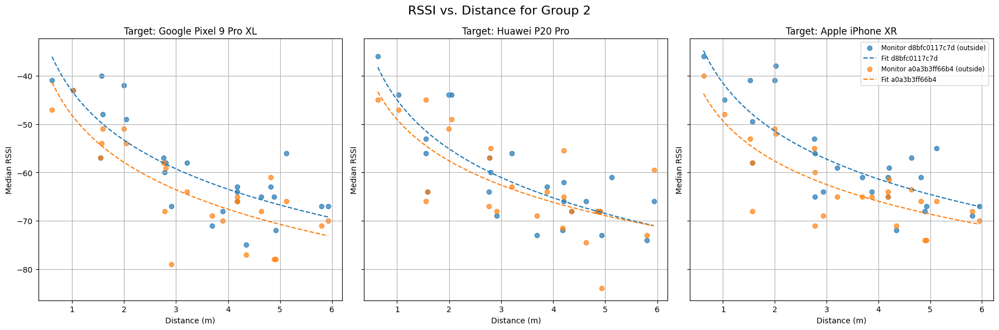

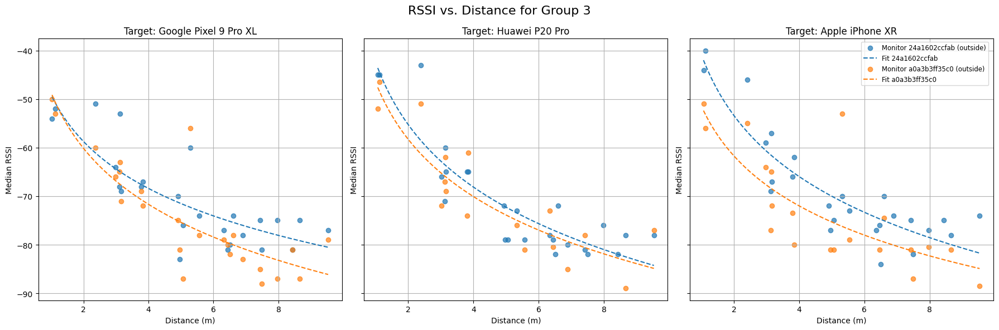

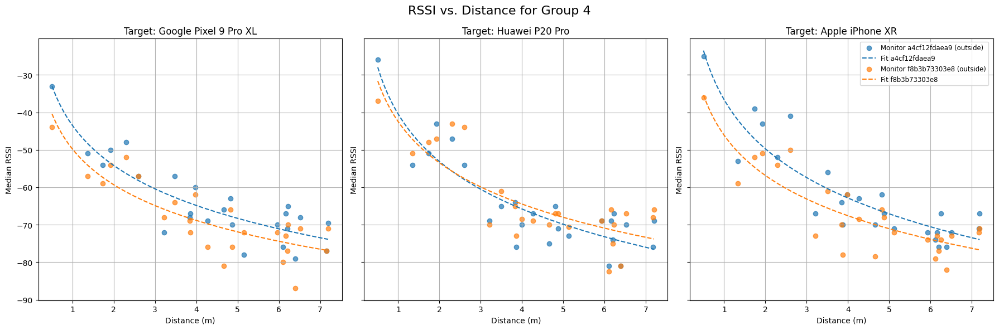

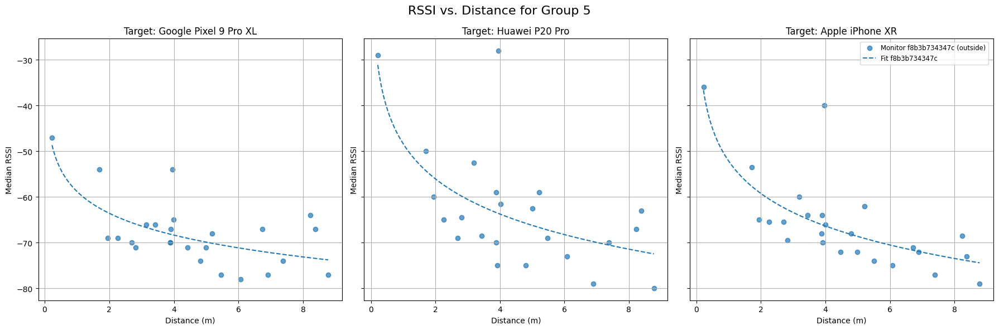

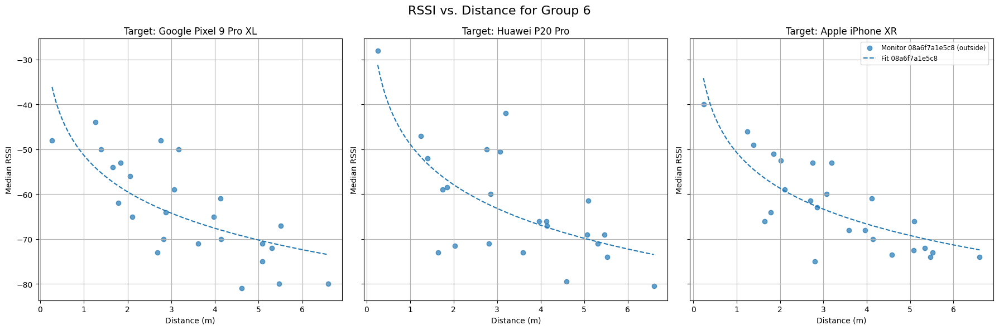

Eval:


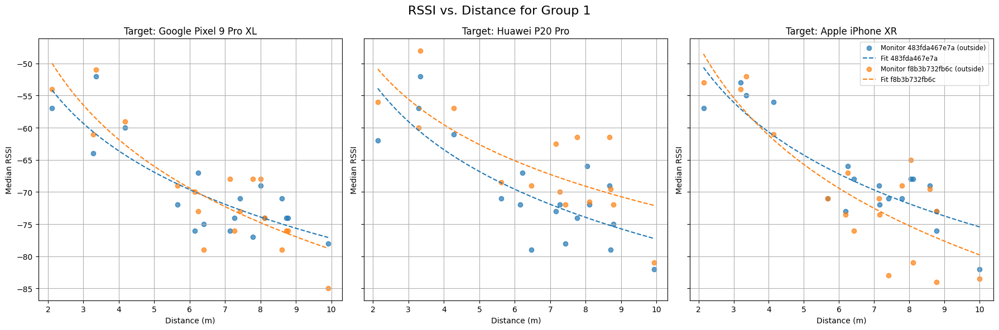

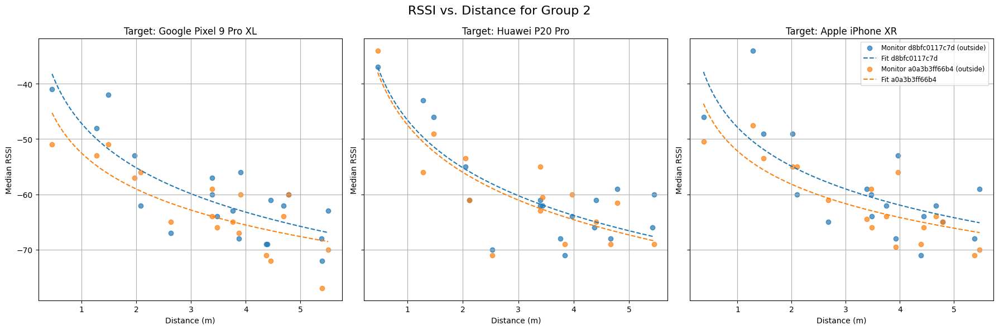

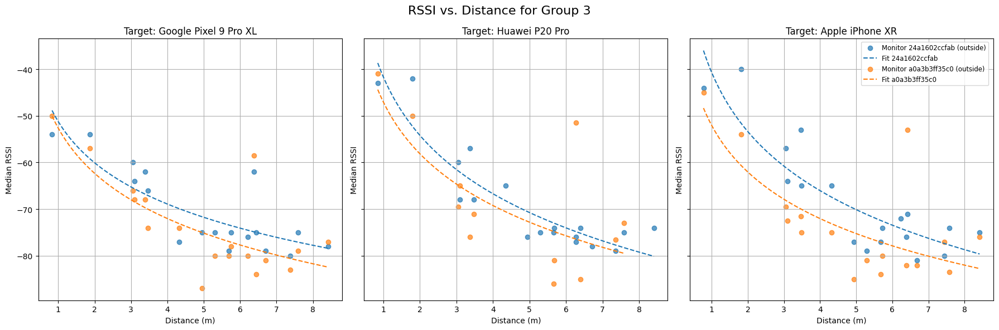

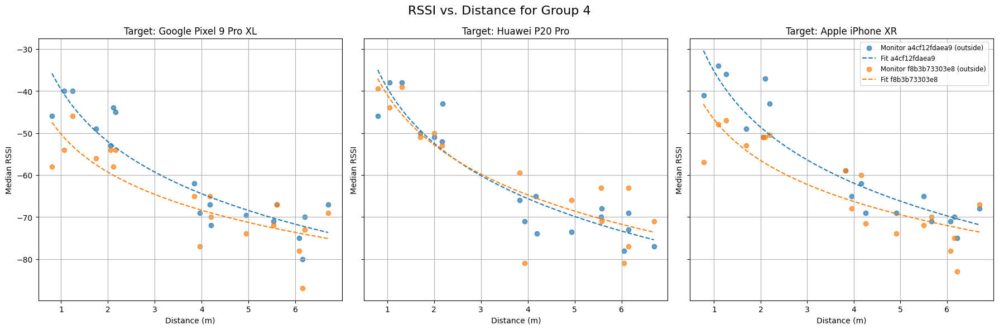

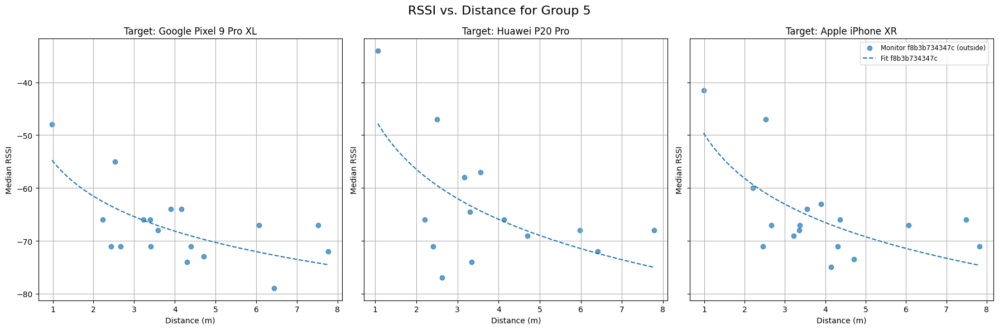

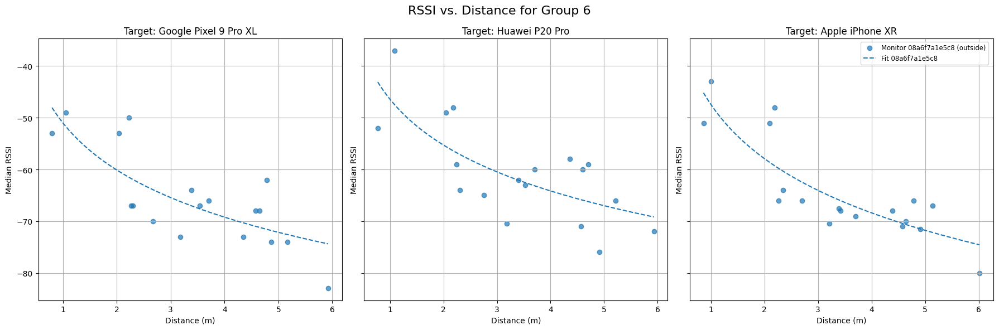

In [16]:
# fingerprint data
print("Fingerprint:")
df_fingerprint_distances = get_distance_and_classify(df_fingerprint_median)
df_fingerprint_model_params = fit_path_loss_model(df_fingerprint_distances)
plot_rssi_vs_distance(df_fingerprint_distances, df_fingerprint_model_params)

# eval data
print("Eval:")
df_eval_distances = get_distance_and_classify(df_eval_median)
df_eval_model_params = fit_path_loss_model(df_eval_distances)
plot_rssi_vs_distance(df_eval_distances, df_eval_model_params)

In [17]:
df_eval_distances

,index,target_position,target_mac,monitor_mac,anchor_position,rssi,class,distance
0,0,"(101, 656)",20f094118214,08a6f7a1e5c8,"(270, 387)",-73.0,outside,3.176822
1,1,"(101, 656)",20f094118214,24a1602ccfab,"(744, 844)",-79.0,outside,6.699201
2,2,"(101, 656)",20f094118214,483fda467e7a,"(62, 42)",-76.0,outside,6.152374
3,3,"(101, 656)",20f094118214,a0a3b3ff35c0,"(744, 844)",-81.0,outside,6.699201
4,4,"(101, 656)",20f094118214,a0a3b3ff66b4,"(556, 510)",-60.0,outside,4.778504
...,...,...,...,...,...,...,...,...
516,175,"(701, 542)",d81c79de34e1,a4cf12fdaea9,"(56, 723)",-68.0,outside,6.699149
517,176,"(701, 542)",d81c79de34e1,d8bfc0117c7d,"(556, 510)",-49.0,outside,1.484891
518,177,"(701, 542)",d81c79de34e1,f8b3b732fb6c,"(62, 42)",-81.0,outside,8.113698
519,178,"(701, 542)",d81c79de34e1,f8b3b73303e8,"(56, 723)",-67.0,outside,6.699149


In [18]:
# inverse Log-distance path loss model
def inverse_log_distance_model(rssi, rssi_0, n):
    return 10 ** ((rssi_0 - rssi) / (10 * n))

def get_user_range_error(df_distance, df_model_params):
    df_combined = pd.merge(df_distance, df_model_params, left_on=["target_mac", "monitor_mac"], right_on=["target_mac", "monitor_mac"], how="left")

    df_combined["estimated_distance"] = df_combined.apply(lambda row: inverse_log_distance_model(row["rssi"], row["rssi_0"], row["n"]), axis=1)
    df_combined["ure"] = df_combined.apply(lambda row: abs(row["distance"] - row["estimated_distance"]), axis=1)

    return df_combined

def plot_ure(dfs_ure, df_labels):
    global target_macs

    # Create a figure with enough space for all subplots
    fig1, axs1 = plt.subplots(1, len(target_macs), figsize=(18, 6), sharey=True)
    fig2, axs2 = plt.subplots(1, len(target_macs), figsize=(18, 6), sharey=True)
    
    # Set the figure title for the current group
    # fig.suptitle(f"RSSI vs. Distance for Group {group_index + 1}", fontsize=16)

    for target_idx, target_mac in enumerate(target_macs):
        df_targets = [df[df["target_mac"] == target_mac] for df in dfs_ure]
        ures = [df_target["ure"].to_numpy() for df_target in df_targets]

        ax1 = axs1[target_idx]  # Get the subplot for this target_mac

        # Plot the boxplots for URE
        ax1.boxplot(ures, 
                    tick_labels=df_labels, 
                    showfliers=False)  # Disable rendering of outliers
        ax1.set_title(f"User Range Error (URE) for {device_names[target_mac]}")
        ax1.set_ylabel("User Range Error (m)")
        ax1.grid(True)
    
        # Sort the URE values for cumulative plotting
        ures_sorted = [np.sort(ure) for ure in ures]
        
        # Calculate the cumulative distribution
        cdfs = [np.arange(1, len(ure_sorted) + 1) / len(ure_sorted) for ure_sorted in ures_sorted]
        
        ax2 = axs2[target_idx]  # Get the subplot for this target_mac

        # Plot the CDF for all monitors and the two groups
        for cdf_idx, cdf in enumerate(cdfs):
            ax2.plot(ures_sorted[cdf_idx], cdf, label=df_labels[cdf_idx], color=plt.cm.tab10(cdf_idx))

        percentiles = [50, 95]

        # Add percentile markers with striped lines
        for p in percentiles:
            ure_percentiles = [np.percentile(ure, p) for ure in ures]
            max_percentile = max(ure_percentiles)

            # Draw dashed lines for "All Monitors"
            ax2.axhline(y=p / 100.0, xmin=0, xmax=max_percentile / ax2.get_xlim()[1], 
                           color='black', linestyle='dashed', linewidth=0.8, alpha=0.7)

            for ure_percentile_idx, ure_percentile in enumerate(ure_percentiles):
                ax2.axvline(x=ure_percentile, ymin=0, ymax=p / 100.0 / ax2.get_ylim()[1], color=plt.cm.tab10(ure_percentile_idx), linestyle='dashed', linewidth=0.8, alpha=0.7)
                #ax2.scatter(ure_percentile, p / 100.0, color=plt.cm.tab10(ure_percentile_idx), marker='o')

        # Add legend
        ax2.legend(
            loc='lower right'
        )

        # Limit the x-axis to 100 meters
        # plt.xlim(0, 100)

        ax2.set_title(f"Cumulative Distribution of URE for {device_names[target_mac]}")
        ax2.set_xlabel("User Range Error (m)")
        ax2.set_ylabel("Cumulative Probability")
        ax2.grid(True)


    fig1.tight_layout()
    fig2.tight_layout()
    plt.show()

def calculate_rms(values):
    """Calculate the Root Mean Square (RMS) of the values."""
    return np.sqrt(np.mean(np.square(values)))

def print_ure_statistics(dfs_ure, df_labels):
    global target_macs
    
    for target_mac in target_macs:
        print(f"For {device_names[target_mac]}:")

        for df, df_label in zip(dfs_ure, df_labels):
            df_target = df[df["target_mac"] == target_mac]
            ure = df_target["ure"].to_numpy()
            rms = calculate_rms(ure)

            # Print the RMS values
            print(f"RMS for {df_label}: {rms:.2f} meters")

        print()

Fingerprint:


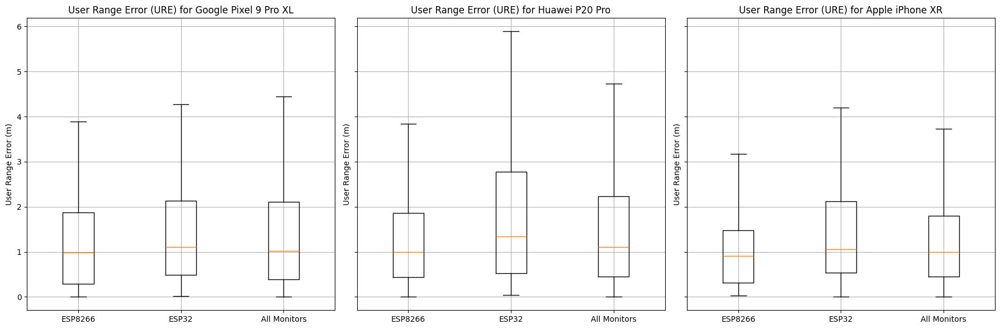

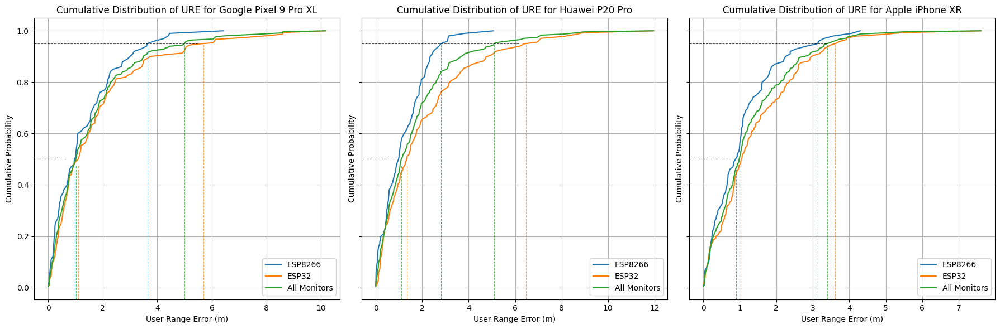

Eval:


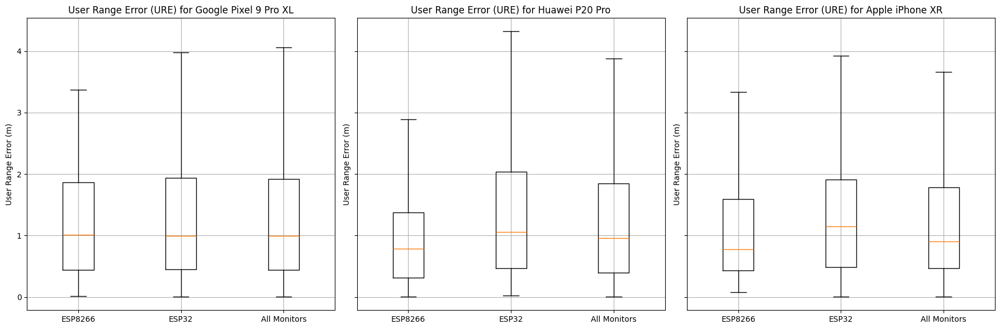

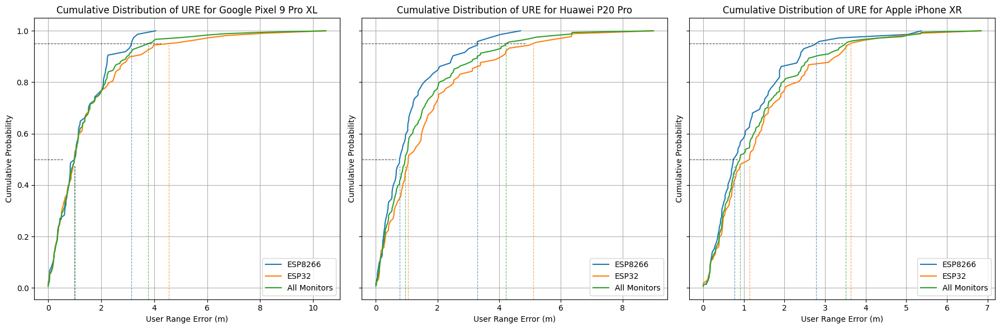

For Google Pixel 9 Pro XL:
RMS for ESP8266: 1.53 meters
RMS for ESP32: 2.26 meters
RMS for All Monitors: 2.00 meters

For Huawei P20 Pro:
RMS for ESP8266: 1.49 meters
RMS for ESP32: 2.36 meters
RMS for All Monitors: 2.01 meters

For Apple iPhone XR:
RMS for ESP8266: 1.53 meters
RMS for ESP32: 1.90 meters
RMS for All Monitors: 1.76 meters



In [19]:
df_labels = ["ESP8266", "ESP32", "All Monitors"]

# fingerprint data
print("Fingerprint:")
df_fingerprint_ure_all = get_user_range_error(df_fingerprint_distances, df_fingerprint_model_params)
df_fingerprint_ure_esp8266 = filter_esp8266(df_fingerprint_ure_all)
df_fingerprint_ure_esp32 = filter_esp32(df_fingerprint_ure_all)
dfs_fingerprint_ure = [df_fingerprint_ure_esp8266, df_fingerprint_ure_esp32, df_fingerprint_ure_all]

plot_ure(dfs_fingerprint_ure, df_labels)

# eval data
print("Eval:")
df_eval_ure_all = get_user_range_error(df_eval_distances, df_eval_model_params)
df_eval_ure_esp8266 = filter_esp8266(df_eval_ure_all)
df_eval_ure_esp32 = filter_esp32(df_eval_ure_all)
dfs_eval_ure = [df_eval_ure_esp8266, df_eval_ure_esp32, df_eval_ure_all]

plot_ure(dfs_eval_ure, df_labels)
print_ure_statistics(dfs_eval_ure, df_labels)

### URE for params from previous fingerprinting data

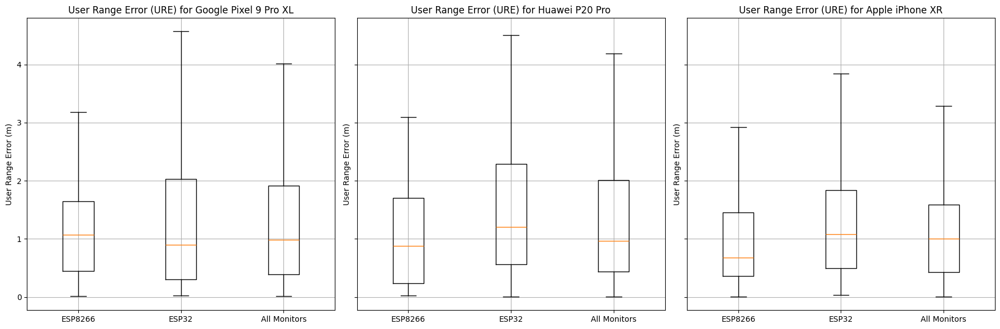

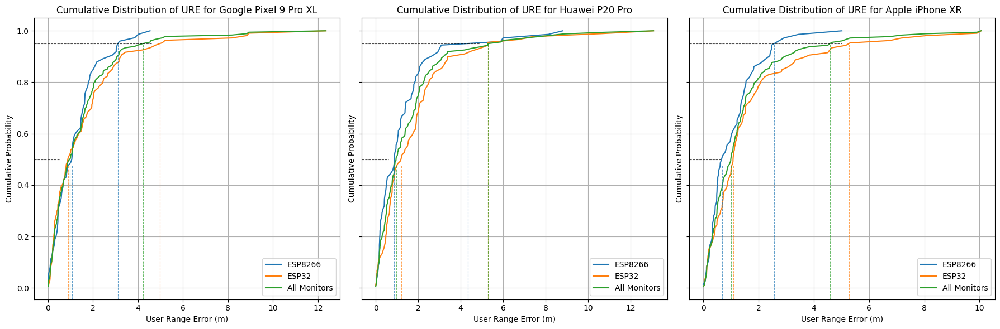

For Google Pixel 9 Pro XL:
RMS for ESP8266: 1.58 meters
RMS for ESP32: 2.56 meters
RMS for All Monitors: 2.21 meters

For Huawei P20 Pro:
RMS for ESP8266: 2.11 meters
RMS for ESP32: 2.80 meters
RMS for All Monitors: 2.52 meters

For Apple iPhone XR:
RMS for ESP8266: 1.38 meters
RMS for ESP32: 2.52 meters
RMS for All Monitors: 2.13 meters



In [20]:
# different data for the model params
df_different_ure_all = get_user_range_error(df_eval_distances, df_fingerprint_model_params)
df_different_ure_esp8266 = filter_esp8266(df_different_ure_all)
df_different_ure_esp32 = filter_esp32(df_different_ure_all)
dfs_different_ure = [df_different_ure_esp8266, df_different_ure_esp32, df_different_ure_all]

plot_ure(dfs_different_ure, df_labels)
print_ure_statistics(dfs_different_ure, df_labels)

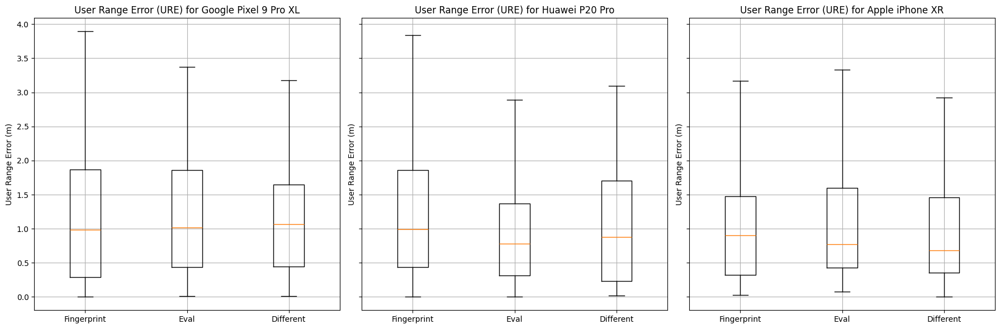

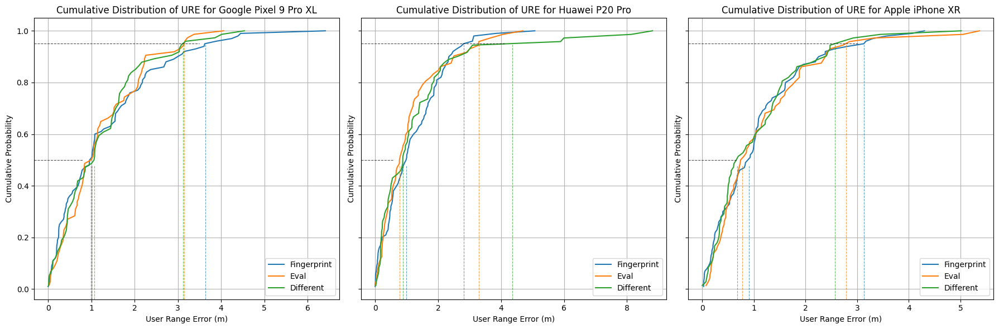

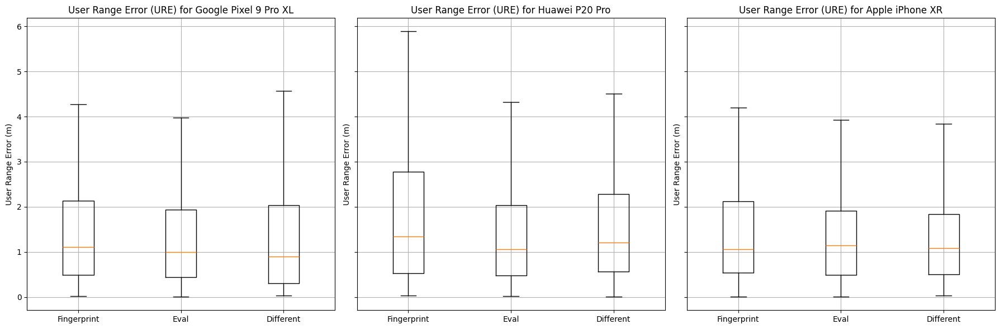

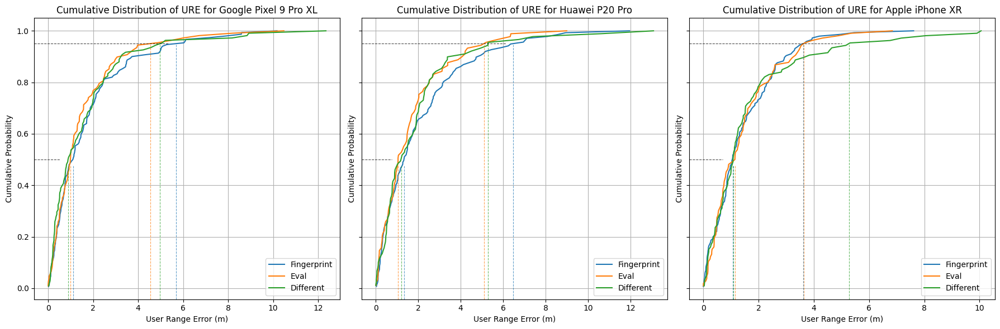

In [21]:
plot_ure([df_fingerprint_ure_esp8266, df_eval_ure_esp8266, df_different_ure_esp8266], ["Fingerprint", "Eval", "Different"])
plot_ure([df_fingerprint_ure_esp32, df_eval_ure_esp32, df_different_ure_esp32], ["Fingerprint", "Eval", "Different"])

In [22]:
df_different_ure_esp32.sort_values("ure")

,index,target_position,target_mac,monitor_mac,anchor_position,rssi,class,distance,rssi_0,n,estimated_distance,ure
204,24,"(168, 594)",342eb61ec446,f8b3b73303e8,"(56, 723)",-51.0,outside,1.708362,-42.465516,3.653924,1.712263,0.003901
137,137,"(438, 681)",20f094118214,f8b3b732fb6c,"(62, 42)",-73.0,outside,7.414155,-45.884454,3.110946,7.440763,0.026608
186,6,"(100, 656)",342eb61ec446,f8b3b73303e8,"(56, 723)",-39.5,outside,0.801561,-42.465516,3.653924,0.829546,0.027985
321,141,"(660, 834)",342eb61ec446,08a6f7a1e5c8,"(270, 387)",-72.0,outside,5.932192,-48.830171,3.005266,5.901661,0.030531
435,94,"(355, 333)",d81c79de34e1,a0a3b3ff66b4,"(556, 510)",-61.0,outside,2.678246,-49.351574,2.759214,2.643410,0.034835
...,...,...,...,...,...,...,...,...,...,...,...,...
468,127,"(435, 836)",d81c79de34e1,f8b3b732fb6c,"(62, 42)",-84.0,outside,8.772485,-40.295759,3.437767,18.676576,9.904090
478,137,"(436, 682)",d81c79de34e1,f8b3b732fb6c,"(62, 42)",-83.0,outside,7.412665,-40.295759,3.437767,17.466609,10.053944
213,33,"(180, 901)",342eb61ec446,f8b3b734347c,"(441, 934)",-77.0,outside,2.630779,-48.381307,2.551808,13.228375,10.597596
69,69,"(211, 333)",20f094118214,f8b3b734347c,"(441, 934)",-79.0,outside,6.435068,-58.797623,1.586002,18.784184,12.349116


### Accuracy

In [23]:
from abc import ABC, abstractmethod
import numpy as np
import pandas as pd
from scipy.interpolate import Rbf

def inverse_path_loss_model(rssi, rssi_0, n):
    distance = pow(10, ((rssi_0 - rssi) / (10.0 * n)))
    return distance

class AbstractLocalization(ABC):

    def __init__(self):
        pass

    @abstractmethod
    def localize(self, rssis):
        pass
    
    def get_relevant_anchor_stats(self, anchor_stats, rssis):
        monitor_macs_intersec = anchor_stats.keys() & rssis.keys()
        anchor_stats_intersec = [anchor_stats[monitor_mac] for monitor_mac in monitor_macs_intersec]
        rssis_intersec = [rssis[monitor_mac] for monitor_mac in monitor_macs_intersec]
        
        return monitor_macs_intersec, anchor_stats_intersec, rssis_intersec

class TrilaterationLeastSquaresLocalization(AbstractLocalization):
    def __init__(self, anchor_positions, monitor_model_params):
        super().__init__()
        
        self.anchor_positions = anchor_positions
        self.monitor_model_params = monitor_model_params
    
    def localize(self, rssis):
        relevant_monitor_macs, relevant_positions, relevant_rssis = self.get_relevant_anchor_stats(self.anchor_positions, rssis)
        relevant_distances = [inverse_path_loss_model(rssi, self.monitor_model_params[monitor_mac][0], self.monitor_model_params[monitor_mac][1]) * 100.0 for rssi, monitor_mac in zip(relevant_rssis, relevant_monitor_macs)] # m to cm

        relevant_positions = np.array(relevant_positions)
        relevant_distances = np.array(relevant_distances)
        print(relevant_positions)

        # relevant_positions = relevant_positions / 100.0
        # relevant_distances = relevant_distances / 100.0

        print("rssis:")
        print(relevant_rssis)
        print("positions:")
        print(relevant_positions)
        print("distances:")
        print(relevant_distances)
        
        # Number of known positions
        n = len(relevant_positions)
        
        # Build the A matrix and b vector
        A = []
        b = []
        
        x_n, y_n = relevant_positions[n-1]
        d_n = relevant_distances[n-1]
        for i in range(n - 1):
            x_i, y_i = relevant_positions[i]
            d_i = relevant_distances[i]
            A.append([2*(x_i - x_n), 2*(y_i - y_n)])
            b.append(x_i**2 + y_i**2 - x_n**2 - y_n**2 - d_i**2 + d_n**2)
        A = np.array(A)
        b = np.array(b)

        print("A:")
        print(A)
        print("b:")
        print(b)

        # Debug: Check condition number
        condition_number = np.linalg.cond(A.T @ A)
        print(f"Condition Number: {condition_number}")

        # Compute the least squares solution using the normal equation: x = (A^T A)^(-1) A^T b
        position, residuals, rank, s = np.linalg.lstsq(A, b, rcond=None)

        print("Lstsq data:")
        print(position)
        print(residuals)
        print(rank)
        print(s)

        # position *= 100.0
        
        return {
            'position': position,
            'distances': {monitor_mac: distance for monitor_mac, distance in zip(relevant_monitor_macs, relevant_distances)}
        }

class TrilaterationWeightedCentroidLocalization(AbstractLocalization):
    def __init__(self, anchor_positions, monitor_model_params, weight_func):
        super().__init__()
        
        self.anchor_positions = anchor_positions
        self.monitor_model_params = monitor_model_params
        self.weight_func = weight_func
    
    def localize(self, rssis):
        relevant_monitor_macs, relevant_positions, relevant_rssis = self.get_relevant_anchor_stats(self.anchor_positions, rssis)        
        relevant_positions_np = np.array(relevant_positions)

        # Calculate the weights using the custom function
        weights = np.array([self.weight_func(rssi, self.monitor_model_params[monitor_mac][0], self.monitor_model_params[monitor_mac][1]) for rssi, monitor_mac in zip(relevant_rssis, relevant_monitor_macs)])
        weight_sum = np.sum(weights)

        # Normalize the weights so they sum up to 1
        normalized_weights = weights / weight_sum
        
        # Weighted sum of positions
        x = np.sum([w * pos[0] for w, pos in zip(normalized_weights, relevant_positions_np)])
        y = np.sum([w * pos[1] for w, pos in zip(normalized_weights, relevant_positions_np)])
        
        position = (x, y)
        
        return {
            'position': position
        }

class FingerprintingLocalization(AbstractLocalization):
    def __init__(self, df_fingerprints, background_size, heatmap_resolution=5.0): # every 5cm
        super().__init__()
        
        x = np.arange(0, background_size[0], heatmap_resolution)
        y = np.arange(0, background_size[1], heatmap_resolution)
        self.pos_lookup_x = np.append(x, background_size[0]) # include boundary
        self.pos_lookup_y = np.append(y, background_size[1])
        num_x = len(self.pos_lookup_x)
        num_y = len(self.pos_lookup_y)
            
        gx, gy = np.meshgrid(self.pos_lookup_x, self.pos_lookup_y)
        gx, gy = gx.flatten(), gy.flatten()
        
        def generate_interpolated_fingerprint_map(monitor_mac):
            monitor_rows = df_fingerprints[df_fingerprints['monitor_mac'] == monitor_mac]
            
            target_positions = monitor_rows['target_position'].to_list()
            (target_positions_x, target_positions_y) = zip(*target_positions)
            rssi_medians = monitor_rows['rssi'].to_list()
            
            
            # from https://github.com/jantman/python-wifi-survey-heatmap/blob/master/wifi_survey_heatmap/heatmap.py
            
            rbf = Rbf(target_positions_x, target_positions_y, rssi_medians, function='linear')
            z = rbf(gx, gy)
            z = z.reshape((num_y, num_x))
            
            return z
        
        monitor_macs = df_fingerprints['monitor_mac'].unique()
        self.interpolated_fingerprints = {monitor_mac: generate_interpolated_fingerprint_map(monitor_mac) for monitor_mac in monitor_macs}
    
    def localize(self, rssis):
        _, relevant_interpolated_fingerprints, relevant_rssis = self.get_relevant_anchor_stats(self.interpolated_fingerprints, rssis)
        
        diff = np.moveaxis(relevant_interpolated_fingerprints, 0, -1) - relevant_rssis        
        norm = np.linalg.norm(diff, axis=2)
        min_pos_heatmap = np.unravel_index(np.argmin(norm, axis=None), norm.shape)        
        min_pos = (self.pos_lookup_x[min_pos_heatmap[1]], self.pos_lookup_y[min_pos_heatmap[0]])
        
        position = min_pos
        
        return {
            'position': position,
            'heatmap': norm
        }

In [24]:
def combine_df_model_params(df, df_model_params):
    return pd.merge(df, df_model_params, left_on=["target_mac", "monitor_mac"], right_on=["target_mac", "monitor_mac"], how="left")

df_fingerprint_combined = combine_df_model_params(df_fingerprint_distances, df_fingerprint_model_params)
df_eval_combined = combine_df_model_params(df_eval_distances, df_eval_model_params)
df_different_combined = combine_df_model_params(df_eval_distances, df_fingerprint_model_params)

df_fingerprint_combined

,index,target_position,target_mac,monitor_mac,anchor_position,rssi,class,distance,rssi_0,n
0,0,"(100, 594)",20f094118214,08a6f7a1e5c8,"(270, 387)",-73.0,outside,2.678600,-51.336019,2.702700
1,1,"(100, 594)",20f094118214,24a1602ccfab,"(744, 844)",-78.0,outside,6.908227,-49.045213,3.215116
2,2,"(100, 594)",20f094118214,483fda467e7a,"(62, 42)",-75.0,outside,5.533064,-45.344191,3.043456
3,3,"(100, 594)",20f094118214,a0a3b3ff35c0,"(744, 844)",-83.0,outside,6.908227,-48.583954,3.835128
4,4,"(100, 594)",20f094118214,a0a3b3ff66b4,"(556, 510)",-68.0,outside,4.636723,-48.230231,3.220217
...,...,...,...,...,...,...,...,...,...,...
727,240,"(753, 546)",d81c79de34e1,a4cf12fdaea9,"(56, 723)",-67.0,outside,7.191231,-36.596500,4.362323
728,241,"(753, 546)",d81c79de34e1,d8bfc0117c7d,"(556, 510)",-41.0,outside,2.002623,-41.536176,3.294653
729,242,"(753, 546)",d81c79de34e1,f8b3b732fb6c,"(62, 42)",-70.0,outside,8.552760,-40.295759,3.437767
730,243,"(753, 546)",d81c79de34e1,f8b3b73303e8,"(56, 723)",-71.0,outside,7.191231,-46.087600,3.572985


In [67]:
def estimate_positions(df_combined):
    def calculate_distance(target_pos, est_pos):
        return np.sqrt((est_pos[0] - target_pos[0])**2 + (est_pos[1] - target_pos[1])**2)

    def aggregate_positions(group):
        anchor_positions = group.set_index('monitor_mac')['anchor_position'].to_dict()
        anchor_rssis = group.set_index('monitor_mac')['rssi'].to_dict()
        anchor_model_params = group.set_index('monitor_mac')[['rssi_0', 'n']].apply(tuple, axis=1).to_dict()
        median_anchor_model_params = group.set_index('monitor_mac')[['median_rssi_0', 'median_n']].apply(tuple, axis=1).to_dict()

        print("GROUP:")
        print(group)

        num_of_datapoints = group.shape[0]
        print("Number of rows:")
        print(num_of_datapoints)

        target_position = group['target_position'].unique()[0]
        print(target_position)

        if num_of_datapoints >= 2:
            if num_of_datapoints >= 3:
                tls = TrilaterationLeastSquaresLocalization(anchor_positions, anchor_model_params)
                estimation_tls = tuple(tls.localize(anchor_rssis)['position'])
                distance_error_tls = calculate_distance(target_position, estimation_tls)

                tls_median = TrilaterationLeastSquaresLocalization(anchor_positions, median_anchor_model_params)
                estimation_tls_median = tuple(tls_median.localize(anchor_rssis)['position'])
                distance_error_tls_median = calculate_distance(target_position, estimation_tls_median)
            else:
                estimation_tls = None
                distance_error_tls = None
                estimation_tls_median = None
                distance_error_tls_median = None

            def weight_distance_2(rssi, rssi_0, n):
                return pow(inverse_path_loss_model(rssi, rssi_0, n), -2.0) # try different exponents → 1.5 worked best
            
            twcl_dist_2 = TrilaterationWeightedCentroidLocalization(anchor_positions, anchor_model_params, weight_distance_2)
            estimation_twcl_dist_2 = tuple(twcl_dist_2.localize(anchor_rssis)['position'])
            distance_error_twcl_dist_2 = calculate_distance(target_position, estimation_twcl_dist_2)

            def weight_rssi_8(rssi, rssi_0, n):
                return pow(abs(rssi), -8.0) # try different exponents → 9 worked best
            
            twcl_rssi_8 = TrilaterationWeightedCentroidLocalization(anchor_positions, anchor_model_params, weight_rssi_8)
            estimation_twcl_rssi_8 = tuple(twcl_rssi_8.localize(anchor_rssis)['position'])
            distance_error_twcl_rssi_8 = calculate_distance(target_position, estimation_twcl_rssi_8)

            print("target_macs_")
            df_fingerprints_target_mac = df_fingerprint_median[df_fingerprint_median["target_mac"] == group["target_mac"].unique().item()]
            print(df_fingerprints_target_mac)
            
            fpl = FingerprintingLocalization(df_fingerprints_target_mac, (819, 965)) # TODO: replace with real size
            estimation_fpl = tuple(fpl.localize(anchor_rssis)['position'])
            distance_error_fpl = calculate_distance(target_position, estimation_fpl)
        else:
            estimation_tls = None
            distance_error_tls = None
            estimation_tls_median = None
            distance_error_tls_median = None
            estimation_twcl_dist_2 = None
            distance_error_twcl_dist_2 = None
            estimation_twcl_rssi_8 = None
            distance_error_twcl_rssi_8 = None
            estimation_fpl = None
            distance_error_fpl = None

        return pd.Series({
            'estimation_tls': estimation_tls,
            'distance_error_tls': distance_error_tls,
            'estimation_tls_median': estimation_tls_median,
            'distance_error_tls_median': distance_error_tls_median,
            'estimation_twcl_dist_2': estimation_twcl_dist_2,
            'distance_error_twcl_dist_2': distance_error_twcl_dist_2,
            'estimation_twcl_rssi_8': estimation_twcl_rssi_8,
            'distance_error_twcl_rssi_8': distance_error_twcl_rssi_8,
            'estimation_fpl': estimation_fpl,
            'distance_error_fpl': distance_error_fpl,
        })
    
    df_median_params = df_combined.copy()
    df_median_params['median_rssi_0'] = df_median_params.groupby('target_mac')['rssi_0'].transform('median')
    df_median_params['median_n'] = df_median_params.groupby('target_mac')['n'].transform('median')

    return df_median_params.groupby(['target_mac', 'target_position'])[['target_mac', 'target_position', 'monitor_mac', 'anchor_position', 'rssi', 'rssi_0', 'n', 'median_rssi_0', 'median_n']].apply(aggregate_positions).reset_index()

In [69]:
import matplotlib.pyplot as plt
from matplotlib.pyplot import get_cmap

def plot_distances(df, target_position, estimated_position, background_image_path = "./images/apb_3081_scaled_fingerprints.png"):
    """
    Plot monitors (anchors) and circles representing distances and estimated distances.

    Parameters:
    - df: pandas DataFrame with columns: 'anchor_position', 'distance', 'estimated_distance', 'target_position'.
    """
    # Initialize the plot
    fig, ax = plt.subplots(figsize=(8, 8))

    # Plot background image if provided
    if background_image_path:
        img = plt.imread(background_image_path)
        ax.imshow(img, aspect='auto', alpha=0.5)

    # Get a colormap
    cmap = get_cmap("tab10")

    # Plot the target position as a green dot
    ax.plot(*target_position, 'go', label="Target Position")

    # Plot the target position as a green dot
    ax.plot(*estimated_position, 'bo', label="Estimated Position")

    # Loop through each monitor (anchor)
    for idx, (anchor_pos, distance, est_distance) in enumerate(
        zip(df['anchor_position'], df['distance'], df['estimated_distance'])
    ):
        color = cmap(idx % 10)  # Get a distinct color for each monitor

        # Plot the monitor as a dot
        ax.plot(*anchor_pos, 'o', color=color, label=f"Monitor {idx}")

        # Plot the circle for actual distance
        actual_circle = plt.Circle(anchor_pos, distance * 100.0, color=color, linestyle='--', fill=False)
        ax.add_artist(actual_circle)

        # Plot the circle for estimated distance
        estimated_circle = plt.Circle(anchor_pos, est_distance * 100.0, color=color, linestyle='-', fill=False)
        ax.add_artist(estimated_circle)

    # Configure plot appearance
    ax.set_aspect('equal', adjustable='datalim')
    ax.legend(loc="upper right")
    plt.xlabel("X Position (cm)")
    plt.ylabel("Y Position (cm)")
    plt.title("Multilateration Visualization")
    plt.grid(True)
    plt.show()

In [70]:
def get_localization_error_stats(df_estimated):
    return df_estimated.groupby("target_mac")[["distance_error_tls", "distance_error_tls_median", "distance_error_twcl_dist_2", "distance_error_twcl_rssi_8", "distance_error_fpl"]].agg({
        'distance_error_tls': ['mean', 'median', 'min', 'max'],
        'distance_error_tls_median': ['mean', 'median', 'min', 'max'],
        'distance_error_twcl_dist_2': ['mean', 'median', 'min', 'max'],
        'distance_error_twcl_rssi_8': ['mean', 'median', 'min', 'max'],
        'distance_error_fpl': ['mean', 'median', 'min', 'max'],
    })

In [71]:
df_estimated_all = estimate_positions(df_different_ure_all).sort_values("distance_error_tls")
get_localization_error_stats(df_estimated_all)

GROUP:
     target_mac target_position   monitor_mac anchor_position  rssi  \
0  20f094118214      (101, 656)  08a6f7a1e5c8      (270, 387) -73.0   
1  20f094118214      (101, 656)  24a1602ccfab      (744, 844) -79.0   
2  20f094118214      (101, 656)  483fda467e7a        (62, 42) -76.0   
3  20f094118214      (101, 656)  a0a3b3ff35c0      (744, 844) -81.0   
4  20f094118214      (101, 656)  a0a3b3ff66b4      (556, 510) -60.0   
5  20f094118214      (101, 656)  a4cf12fdaea9       (56, 723) -46.0   
6  20f094118214      (101, 656)  d8bfc0117c7d      (556, 510) -60.0   
7  20f094118214      (101, 656)  f8b3b732fb6c        (62, 42) -70.0   
8  20f094118214      (101, 656)  f8b3b73303e8       (56, 723) -58.0   
9  20f094118214      (101, 656)  f8b3b734347c      (441, 934) -71.0   

      rssi_0         n  median_rssi_0  median_n  
0 -51.336019  2.702700     -48.230231  3.215116  
1 -49.045213  3.215116     -48.230231  3.215116  
2 -45.344191  3.043456     -48.230231  3.215116  
3 -48.58395

distance_error_tls                                      \
                           mean      median        min          max   
target_mac                                                            
20f094118214         260.843262  181.628130  23.635780   968.785063   
342eb61ec446         302.043910  216.625495  18.563877  1457.756638   
d81c79de34e1         268.396538  174.747640  15.605665   745.831666   

             distance_error_tls_median                                      \
                                  mean      median        min          max   
target_mac                                                                   
20f094118214                261.924577  210.555272  75.281539  1147.595081   
342eb61ec446                283.755538  223.805839  28.600308   785.132012   
d81c79de34e1                479.725248  464.078546  47.509730  1133.638469   

             distance_error_twcl_dist_2                                     \
                                   mean      median        min         max   
target_mac                                                                   
20f094118214                 109.570273   88.331353  47.440071  204.819041   
342eb61ec446                 110.442696   86.308340  41.515235  281.713844   
d81c79de34e1                 114.530903  102.305771  37.937563  212.704610   

             distance_error_twcl_rssi_8                                    \
                                   mean     median        min         max   
target_mac                                                                  
20f094118214                  96.952353  79.037308  24.347359  213.220513   
342eb61ec446                 115.024686  98.143729  28.246475  302.205693   
d81c79de34e1                 107.407034  96.884907  37.968197  211.255805   

             distance_error_fpl                                     
                           mean      median        min         max  
target_mac                                                          
20f094118214          82.689294   66.216896  22.472205  197.699267  
342eb61ec446         127.508251  107.502193  34.205263  312.899345  
d81c79de34e1          91.435335   64.894719   7.280110  303.606653

In [72]:
df_estimated_esp8266 = estimate_positions(df_different_ure_esp8266).sort_values("distance_error_tls")
get_localization_error_stats(df_estimated_esp8266)

GROUP:
     target_mac target_position   monitor_mac anchor_position  rssi  \
1  20f094118214      (101, 656)  24a1602ccfab      (744, 844) -79.0   
2  20f094118214      (101, 656)  483fda467e7a        (62, 42) -76.0   
5  20f094118214      (101, 656)  a4cf12fdaea9       (56, 723) -46.0   
6  20f094118214      (101, 656)  d8bfc0117c7d      (556, 510) -60.0   

      rssi_0         n  median_rssi_0  median_n  
1 -49.045213  3.215116      -43.50056  3.366199  
2 -45.344191  3.043456      -43.50056  3.366199  
5 -43.500560  3.546544      -43.50056  3.366199  
6 -43.213476  3.366199      -43.50056  3.366199  
Number of rows:
4
(101, 656)
[[ 62  42]
 [ 56 723]
 [556 510]
 [744 844]]
rssis:
[-76.0, -46.0, -60.0, -79.0]
positions:
[[ 62  42]
 [ 56 723]
 [556 510]
 [744 844]]
distances:
[1016.87968609  117.61843015  315.26732306  854.44866793]
A:
[[-1364 -1604]
 [-1376  -242]
 [ -376  -668]]
b:
[-1564225.76985464   -23758.56898112   -65946.95886205]
Condition Number: 9.187893960391131
Lstsq da

distance_error_tls                                      \
                           mean      median        min          max   
target_mac                                                            
20f094118214         230.477569  242.031733  42.833987   665.361074   
342eb61ec446         335.088947  175.128393  36.742780  1462.575613   
d81c79de34e1         171.740897  137.981727   8.250096   599.931846   

             distance_error_tls_median                                      \
                                  mean      median        min          max   
target_mac                                                                   
20f094118214                365.196172  281.893389  97.418378  1105.022493   
342eb61ec446                188.169624  162.621819  48.050101   454.940739   
d81c79de34e1                207.650431  157.684307   6.913076   485.980828   

             distance_error_twcl_dist_2                                     \
                                   mean      median        min         max   
target_mac                                                                   
20f094118214                 102.849917   77.096461   7.405706  214.843200   
342eb61ec446                 123.600825  108.020704  28.799145  250.670547   
d81c79de34e1                 116.592306  106.963843  41.392771  210.287754   

             distance_error_twcl_rssi_8                                     \
                                   mean      median        min         max   
target_mac                                                                   
20f094118214                 111.302089  107.677760  21.444317  222.752158   
342eb61ec446                 134.061106  123.915230  35.818214  254.463351   
d81c79de34e1                 126.571035  115.762655  45.157455  216.187627   

             distance_error_fpl                                     
                           mean      median        min         max  
target_mac                                                          
20f094118214          89.583212   82.079591  16.031220  213.377600  
342eb61ec446         116.806613  107.233971  10.295630  233.548710  
d81c79de34e1         118.454141  121.755903  38.288379  234.616709

Min error:


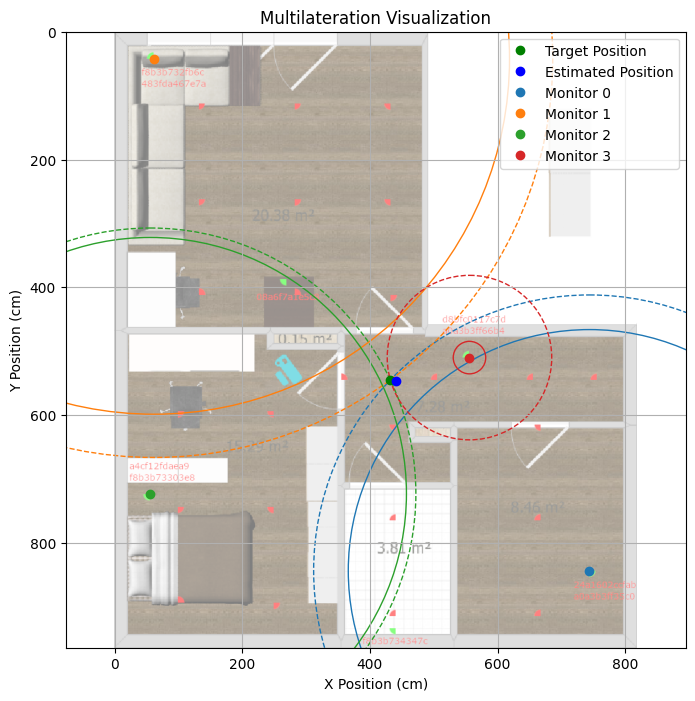

Max error:


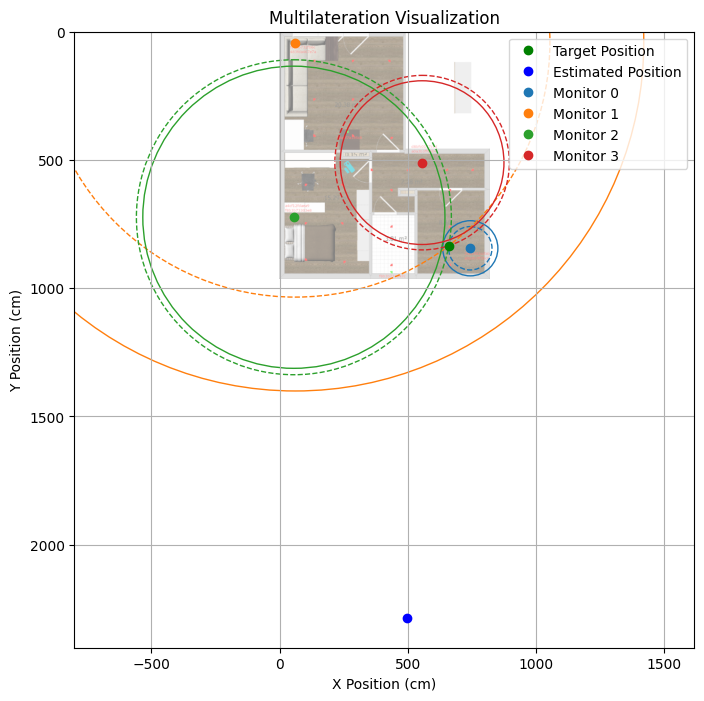

In [73]:
df_estimated_esp8266_row_min_error = df_estimated_esp8266[df_estimated_esp8266["distance_error_tls"] == df_estimated_esp8266["distance_error_tls"].min()]
df_estimated_esp8266_row_max_error = df_estimated_esp8266[df_estimated_esp8266["distance_error_tls"] == df_estimated_esp8266["distance_error_tls"].max()]

df_estimated_esp8266_min = df_eval_ure_esp8266[(df_eval_ure_esp8266["target_mac"] == df_estimated_esp8266_row_min_error["target_mac"].item()) & (df_eval_ure_esp8266["target_position"] == df_estimated_esp8266_row_min_error["target_position"].item())]
df_estimated_esp8266_max = df_eval_ure_esp8266[(df_eval_ure_esp8266["target_mac"] == df_estimated_esp8266_row_max_error["target_mac"].item()) & (df_eval_ure_esp8266["target_position"] == df_estimated_esp8266_row_max_error["target_position"].item())]

print("Min error:")
plot_distances(df_estimated_esp8266_min, df_estimated_esp8266_row_min_error["target_position"].item(), df_estimated_esp8266_row_min_error["estimation_tls"].item(), "./images/flat_scaled_fingerprints.png")
print("Max error:")
plot_distances(df_estimated_esp8266_max, df_estimated_esp8266_row_max_error["target_position"].item(), df_estimated_esp8266_row_max_error["estimation_tls"].item(), "./images/flat_scaled_fingerprints.png")

In [74]:
df_estimated_esp32 = estimate_positions(df_different_ure_esp32).sort_values("distance_error_tls")
get_localization_error_stats(df_estimated_esp32)

GROUP:
     target_mac target_position   monitor_mac anchor_position  rssi  \
0  20f094118214      (101, 656)  08a6f7a1e5c8      (270, 387) -73.0   
3  20f094118214      (101, 656)  a0a3b3ff35c0      (744, 844) -81.0   
4  20f094118214      (101, 656)  a0a3b3ff66b4      (556, 510) -60.0   
7  20f094118214      (101, 656)  f8b3b732fb6c        (62, 42) -70.0   
8  20f094118214      (101, 656)  f8b3b73303e8       (56, 723) -58.0   
9  20f094118214      (101, 656)  f8b3b734347c      (441, 934) -71.0   

      rssi_0         n  median_rssi_0  median_n  
0 -51.336019  2.702700     -49.192578   3.13698  
3 -48.583954  3.835128     -49.192578   3.13698  
4 -48.230231  3.220217     -49.192578   3.13698  
7 -45.884454  3.110946     -49.192578   3.13698  
8 -49.801201  3.163014     -49.192578   3.13698  
9 -58.797623  1.586002     -49.192578   3.13698  
Number of rows:
6
(101, 656)
[[ 56 723]
 [441 934]
 [556 510]
 [270 387]
 [ 62  42]
 [744 844]]
rssis:
[-58.0, -71.0, -60.0, -73.0, -70.0, -81.0]

distance_error_tls                                      \
                           mean      median        min          max   
target_mac                                                            
20f094118214         385.860010  285.683757  39.379371  1666.505374   
342eb61ec446         485.405617  332.975494  81.518281  1503.037146   
d81c79de34e1         443.446176  290.826934  59.358996  1194.389780   

             distance_error_tls_median                                       \
                                  mean      median         min          max   
target_mac                                                                    
20f094118214                549.440694  398.216873   89.202553  2036.329188   
342eb61ec446                685.359343  352.917919   20.938986  2451.782710   
d81c79de34e1                590.437460  502.369060  105.663505  1598.840738   

             distance_error_twcl_dist_2                                     \
                                   mean      median        min         max   
target_mac                                                                   
20f094118214                 125.352116  126.804597  59.893061  202.076962   
342eb61ec446                 126.592354   93.878797  26.001226  359.491351   
d81c79de34e1                 118.279003  109.322148  40.385303  215.342298   

             distance_error_twcl_rssi_8                                     \
                                   mean      median        min         max   
target_mac                                                                   
20f094118214                 113.063593  100.757841   6.882609  219.776785   
342eb61ec446                 124.616388   98.075231  13.297242  349.464282   
d81c79de34e1                 114.676349  105.565571  28.032644  233.472428   

             distance_error_fpl                                     
                           mean      median        min         max  
target_mac                                                          
20f094118214          75.654774   58.914780   7.810250  156.894869  
342eb61ec446         142.838848  135.608123  25.495098  296.211073  
d81c79de34e1          98.426115   75.579035  34.176015  222.748737

Min error:


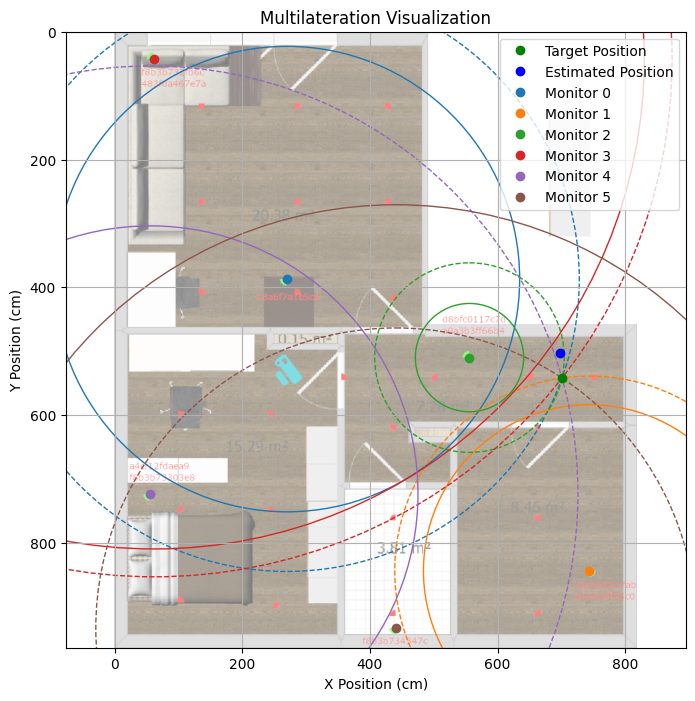

Max error:


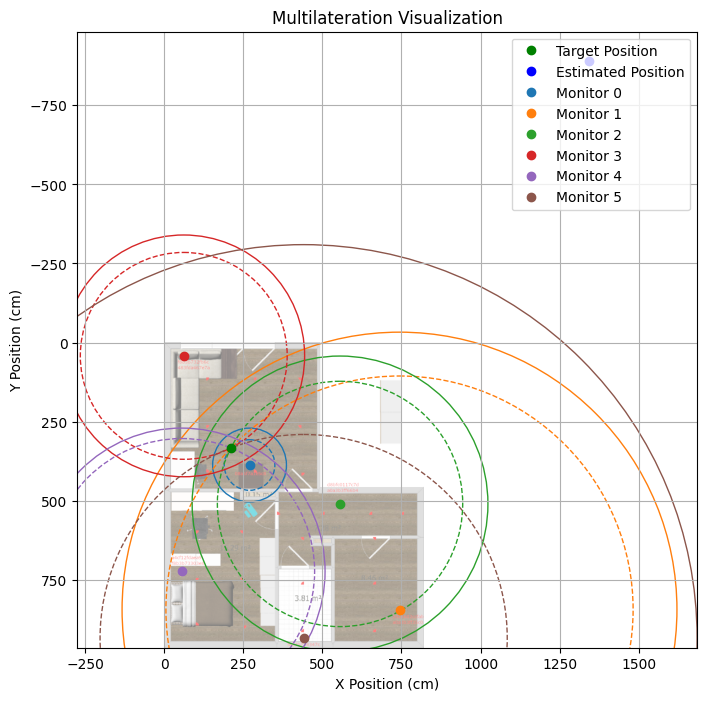

,target_mac,target_position,estimation_tls,distance_error_tls,estimation_tls_median,distance_error_tls_median,estimation_twcl_dist_2,distance_error_twcl_dist_2,estimation_twcl_rssi_8,distance_error_twcl_rssi_8,estimation_fpl,distance_error_fpl
6,20f094118214,"(211, 333)","(1343.1702484097061, -889.8780357170835)",1666.505374,"(-397.62091132494936, 113.46982377965749)",647.003023,"(264.11202699880863, 385.20881835558953)",74.475822,"(253.86955420094662, 373.8161429294849)",59.192535,"(320.0, 280.0)",121.20231


In [75]:
df_estimated_esp32_row_min_error = df_estimated_esp32[df_estimated_esp32["distance_error_tls"] == df_estimated_esp32["distance_error_tls"].min()]
df_estimated_esp32_row_max_error = df_estimated_esp32[df_estimated_esp32["distance_error_tls"] == df_estimated_esp32["distance_error_tls"].max()]

df_estimated_esp32_min = df_eval_ure_esp32[(df_eval_ure_esp32["target_mac"] == df_estimated_esp32_row_min_error["target_mac"].item()) & (df_eval_ure_esp32["target_position"] == df_estimated_esp32_row_min_error["target_position"].item())]
df_estimated_esp32_max = df_eval_ure_esp32[(df_eval_ure_esp32["target_mac"] == df_estimated_esp32_row_max_error["target_mac"].item()) & (df_eval_ure_esp32["target_position"] == df_estimated_esp32_row_max_error["target_position"].item())]

print("Min error:")
plot_distances(df_estimated_esp32_min, df_estimated_esp32_row_min_error["target_position"].item(), df_estimated_esp32_row_min_error["estimation_tls"].item(), "./images/flat_scaled_fingerprints.png")
print("Max error:")
plot_distances(df_estimated_esp32_max, df_estimated_esp32_row_max_error["target_position"].item(), df_estimated_esp32_row_max_error["estimation_tls"].item(), "./images/flat_scaled_fingerprints.png")
df_estimated_esp32_row_max_error

In [201]:
df_eval_ure_esp32[(df_eval_ure_esp32["target_position"] == (1334, 180)) & (df_eval_ure_esp32["target_mac"] == '20f094118214') & (df_eval_ure_esp32["monitor_mac"] == 'a0a3b3ff66b4')]

,index,target_position,target_mac,monitor_mac,anchor_position,rssi,class,distance,rssi_0,n,estimated_distance,ure
116,116,"(1334, 180)",20f094118214,a0a3b3ff66b4,"(107, 884)",-88.0,inside,14.146183,-48.419448,2.43512,42.208927,28.062744


In [202]:
df_eval_ure_esp32[df_eval_ure_esp32["index"] == 116]

,index,target_position,target_mac,monitor_mac,anchor_position,rssi,class,distance,rssi_0,n,estimated_distance,ure
116,116,"(1334, 180)",20f094118214,a0a3b3ff66b4,"(107, 884)",-88.0,inside,14.146183,-48.419448,2.43512,42.208927,28.062744


In [229]:
new_rssi = -88
rssi_0_value = df_eval_ure_esp32[df_eval_ure_esp32["index"] == 116]["rssi_0"].item()
n_value = df_eval_ure_esp32[df_eval_ure_esp32["index"] == 116]["n"].item()
new_distance_value = inverse_path_loss_model(new_rssi, rssi_0_value, n_value)
tmp = df_eval_ure_esp32.assign(rssi=df_eval_ure_esp32["rssi"].where(df_eval_ure_esp32.index != 116, new_rssi))
tmp = tmp.assign(estimated_distance=tmp["estimated_distance"].where(tmp.index != 116, new_distance_value))
tmp[tmp["index"] == 116]

,index,target_position,target_mac,monitor_mac,anchor_position,rssi,class,distance,rssi_0,n,estimated_distance,ure
116,116,"(1334, 180)",20f094118214,a0a3b3ff66b4,"(107, 884)",-88.0,inside,14.146183,-48.419448,2.43512,42.208927,28.062744


In [76]:
tmp_estimatd_esp32 = estimate_positions(tmp).sort_values("distance_error_tls")
tmp_estimated_position = tmp_estimatd_esp32[(tmp_estimatd_esp32["target_mac"] == df_estimated_esp32_row_max_error["target_mac"].item()) & (tmp_estimatd_esp32["target_position"] == df_estimated_esp32_row_max_error["target_position"].item())]["estimation_tls"].item()

tmp_esp32_max = tmp[(tmp["target_mac"] == df_estimated_esp32_row_max_error["target_mac"].item()) & (tmp["target_position"] == df_estimated_esp32_row_max_error["target_position"].item())]

print("Max error:")
plot_distances(tmp_esp32_max, df_estimated_esp32_row_max_error["target_position"].item(), tmp_estimated_position)
tmp_estimatd_esp32

NameError: name 'tmp' is not defined

- numerical instability because of very large values in the matrices
- outlier appears very far away
- only values from 3 (instead of 4) monitors → no redundancy → error has large impact

### Error visualization for twcl:

Min error:


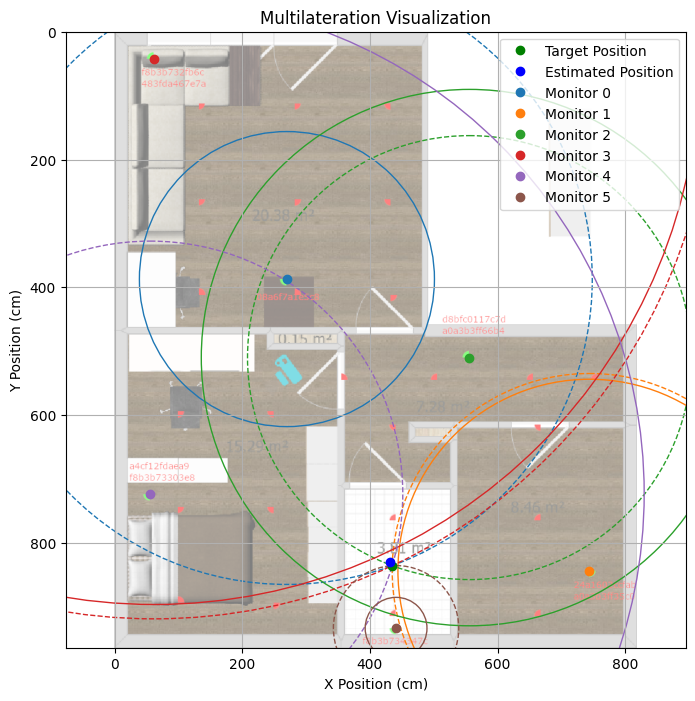

Max error:


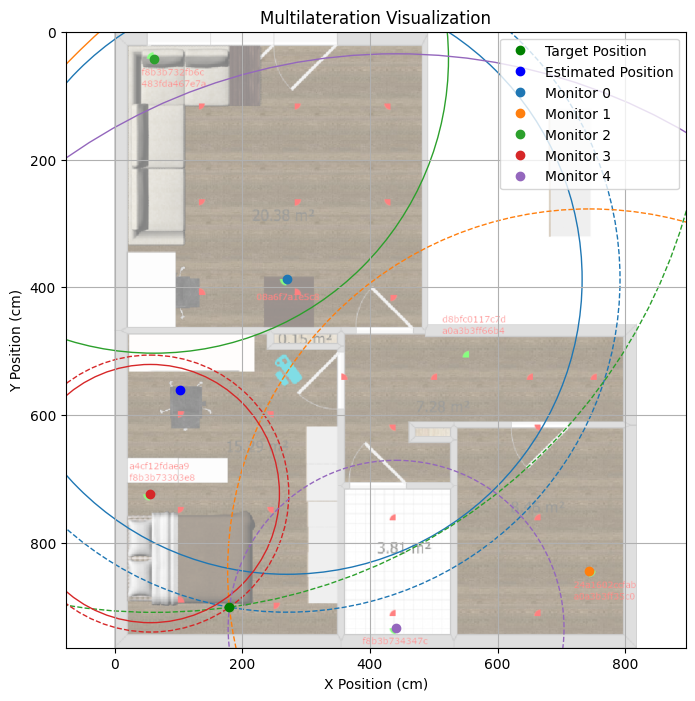

,target_mac,target_position,estimation_tls,distance_error_tls,estimation_tls_median,distance_error_tls_median,estimation_twcl_dist_2,distance_error_twcl_dist_2,estimation_twcl_rssi_8,distance_error_twcl_rssi_8,estimation_fpl,distance_error_fpl
21,342eb61ec446,"(180, 901)","(186.90545866382266, -7.264204701931397)",908.290455,"(-2263.0190551328474, 693.8856554240131)",2451.78271,"(117.01499735943558, 584.3774580637215)",322.826493,"(102.8525579433184, 560.1575778822737)",349.464282,"(15.0, 655.0)",296.211073


In [79]:
df_estimated_esp32_row_min_error_twcl = df_estimated_esp32[df_estimated_esp32["distance_error_twcl_rssi_8"] == df_estimated_esp32["distance_error_twcl_rssi_8"].min()]
df_estimated_esp32_row_max_error_twcl = df_estimated_esp32[df_estimated_esp32["distance_error_twcl_rssi_8"] == df_estimated_esp32["distance_error_twcl_rssi_8"].max()]

df_estimated_esp32_min_twcl = df_eval_ure_esp32[(df_eval_ure_esp32["target_mac"] == df_estimated_esp32_row_min_error_twcl["target_mac"].item()) & (df_eval_ure_esp32["target_position"] == df_estimated_esp32_row_min_error_twcl["target_position"].item())]
df_estimated_esp32_max_twcl = df_eval_ure_esp32[(df_eval_ure_esp32["target_mac"] == df_estimated_esp32_row_max_error_twcl["target_mac"].item()) & (df_eval_ure_esp32["target_position"] == df_estimated_esp32_row_max_error_twcl["target_position"].item())]

print("Min error:")
plot_distances(df_estimated_esp32_min_twcl, df_estimated_esp32_row_min_error_twcl["target_position"].item(), df_estimated_esp32_row_min_error_twcl["estimation_twcl_rssi_8"].item(), "./images/flat_scaled_fingerprints.png")
print("Max error:")
plot_distances(df_estimated_esp32_max_twcl, df_estimated_esp32_row_max_error_twcl["target_position"].item(), df_estimated_esp32_row_max_error_twcl["estimation_twcl_rssi_8"].item(), "./images/flat_scaled_fingerprints.png")
df_estimated_esp32_row_max_error_twcl

In [80]:
df_fingerprint_median

,index,target_position,target_mac,monitor_mac,anchor_position,rssi
0,0,"(100, 594)",20f094118214,08a6f7a1e5c8,"(270, 387)",-73.0
1,1,"(100, 594)",20f094118214,24a1602ccfab,"(744, 844)",-78.0
2,2,"(100, 594)",20f094118214,483fda467e7a,"(62, 42)",-75.0
3,3,"(100, 594)",20f094118214,a0a3b3ff35c0,"(744, 844)",-83.0
4,4,"(100, 594)",20f094118214,a0a3b3ff66b4,"(556, 510)",-68.0
...,...,...,...,...,...,...
727,240,"(753, 546)",d81c79de34e1,a4cf12fdaea9,"(56, 723)",-67.0
728,241,"(753, 546)",d81c79de34e1,d8bfc0117c7d,"(556, 510)",-41.0
729,242,"(753, 546)",d81c79de34e1,f8b3b732fb6c,"(62, 42)",-70.0
730,243,"(753, 546)",d81c79de34e1,f8b3b73303e8,"(56, 723)",-71.0


In [81]:
from matplotlib.ticker import AutoMinorLocator

def plot_localization_error(df, group_name):
    # Calculate the mean error per target device for each algorithm
    agg_df = df.groupby('target_mac')[["distance_error_tls", "distance_error_tls_median", "distance_error_twcl_dist_2", "distance_error_twcl_rssi_8", "distance_error_fpl"]].mean().reset_index()

    # Define algorithms and their corresponding distance error columns
    algorithms = ['tls', 'tls_median', 'twcl_dist_2', 'twcl_rssi_8', 'fpl']
    distance_error_cols = [f'distance_error_{algo}' for algo in algorithms]

    # Custom mappings for friendly names
    friendly_names_algo = {
        'tls': 'LST',
        'tls_median': 'LST (Median)',
        'twcl_dist_2': 'WCL (Distance)',
        'twcl_rssi_8': 'WCL (RSSI)',
        'fpl': 'FP',
    }

    # Apply friendly names for the x-axis labels
    agg_df['friendly_name'] = agg_df['target_mac'].map(device_names)

    # Plot setup
    group_spacing = 0.5  # Space between groups
    bar_spacing = 0.05   # Space between bars within a group
    width = 0.15         # Narrower bar width
    x = np.arange(len(agg_df)) * (len(algorithms) * (width + bar_spacing) + group_spacing)

    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot each algorithm's bars
    for i, algo in enumerate(algorithms):
        bar_positions = x + i * (width + bar_spacing)
        ax.bar(
            bar_positions,
            agg_df[f'distance_error_{algo}'] / 100.0,
            width,
            label=friendly_names_algo[algo]
        )

    # Add labels, title, and legend
    ax.set_xlabel('Target Devices', fontsize=12)
    ax.set_ylabel('Mean Distance Error (m)', fontsize=12)
    ax.set_title(f'Mean Distance Error using {group_name}', fontsize=14)
    ax.set_xticks(x + (len(algorithms) - 1) * (width + bar_spacing) / 2)
    ax.set_xticklabels(agg_df['friendly_name'])
    ax.legend(title='Algorithm')

    # Move the legend to the right
    # ax.legend(title='Algorithm', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Enable grid
    ax.grid(True, which='major', axis='y', linestyle=':', linewidth=1.5, alpha=0.8)  # Thicker, solid lines for major ticks
    ax.yaxis.set_minor_locator(AutoMinorLocator(2))
    ax.grid(True, which='minor', axis='y', linestyle=':', linewidth=1.0, alpha=0.8)
    ax.set_axisbelow(True)  # Place grid lines below the bars

    ax.set_ylim(0, 5)
    # ax.set_yscale('log')

    # Display the plot
    plt.tight_layout()
    plt.show()

All:


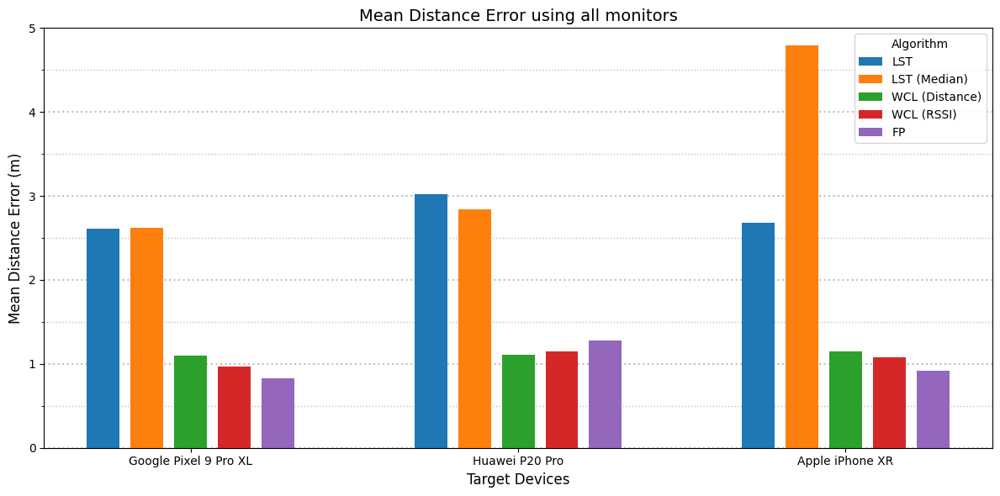

ESP8266:


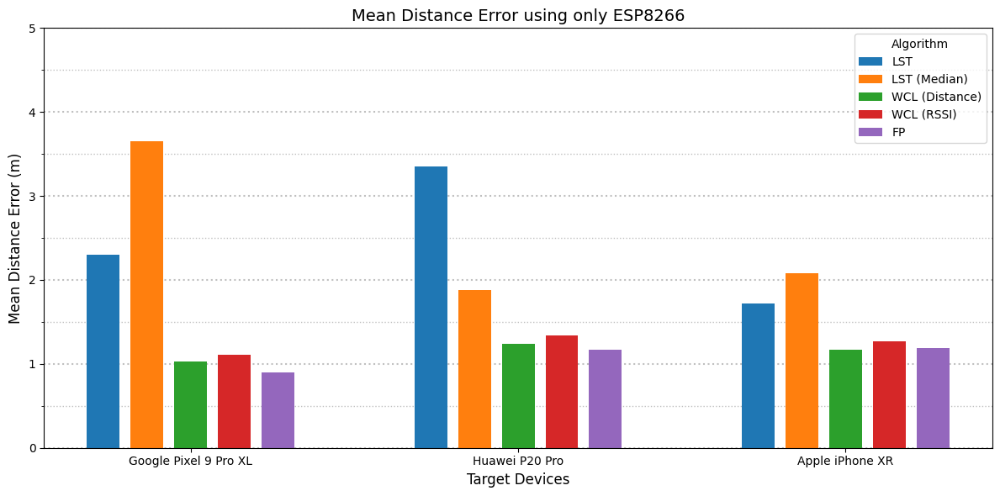

ESP32:


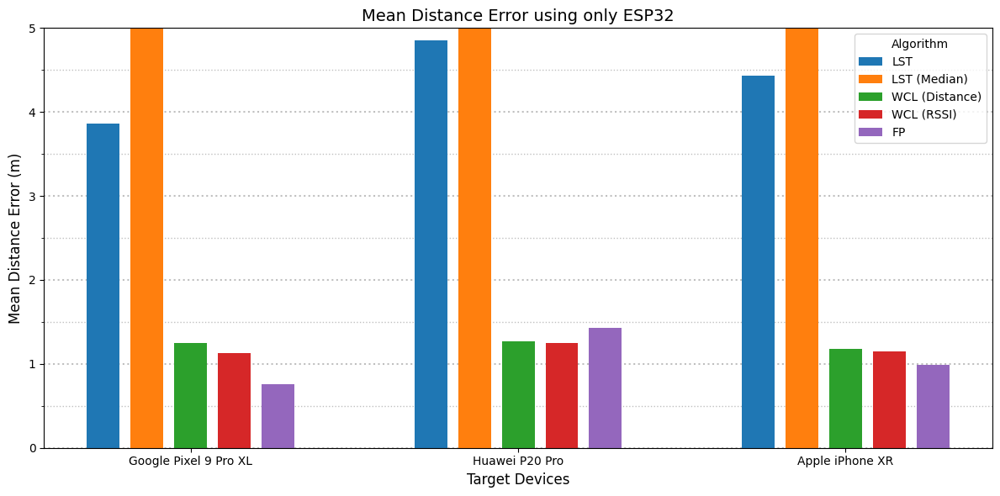

In [82]:
print("All:")
plot_localization_error(df_estimated_all, 'all monitors')
print("ESP8266:")
plot_localization_error(df_estimated_esp8266, 'only ESP8266')
print("ESP32:")
plot_localization_error(df_estimated_esp32, 'only ESP32')